## Slide initial analysis

## 00 Introduction

Date: 04-Mar-2024  
A script to analyse CosMx data, containg TMA, with all the tissues being analysed together.
The analysis contains two main sections:  
* inital overview using just flat files  
* squidpy pipeline to obtain UMAP and using DEGs potentially identity clusters  


## Setup

Libraries

In [1]:
from pathlib import Path
from sklearn.metrics import silhouette_samples, silhouette_score


import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import squidpy as sq

np.random.seed(42)

sc.logging.print_header()

2024-07-02 22:56:35.329569: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-02 22:56:36.911533: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


scanpy==1.9.6 anndata==0.10.3 umap==0.5.4 numpy==1.23.4 scipy==1.12.0 pandas==1.5.3 scikit-learn==1.3.2 statsmodels==0.14.1 igraph==0.10.8 pynndescent==0.5.11


In [2]:
plt.rcParams['savefig.directory'] = '/project/data/gew123/Spatial/plots/'
print(plt.rcParams['savefig.directory'])

/project/data/gew123/Spatial/plots/


In [3]:
filepath = '/project/data/gew123/Spatial/plots/'

Data for initial overview

In [18]:
meta_file = pd.read_csv("../input/slide_0_metadata_file_updated_tissue_meta_with_Patient_Info.csv")
fov_file = pd.read_csv("../input/slide_0_fov_positions_file.csv")

/tmp/ipykernel_4061130/270237367.py:1: DtypeWarning: Columns (21) have mixed types. Specify dtype option on import or set low_memory=False.
  meta_file = pd.read_csv("../input/slide_0_metadata_file_updated_tissue_meta_with_Patient_Info.csv")


In [116]:
meta_file.head()

,fov,cell_ID,Area,AspectRatio,CenterX_local_px,CenterY_local_px,CenterX_global_px,CenterY_global_px,Width,Height,...,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.DAPI,Max.DAPI,tissue,section,subtype,stage
0,1,2,4657,0.95,3644,1488,95035.997899,100191.034702,81,85,...,463,2075,255,1189,114,484,tissue_01,E4,differentiating neuroblastoma,1_2
1,1,3,10996,2.06,3779,1716,95170.997899,99963.034702,183,89,...,37,660,55,3234,138,489,tissue_01,E4,differentiating neuroblastoma,1_2
2,1,4,8122,1.02,3927,1886,95318.997899,99793.034702,103,101,...,474,1335,197,1671,574,1891,tissue_01,E4,differentiating neuroblastoma,1_2
3,1,5,9341,0.82,4077,1919,95468.997899,99760.034702,102,124,...,341,1012,223,2604,514,1377,tissue_01,E4,differentiating neuroblastoma,1_2
4,1,6,4901,1.26,3988,1958,95379.997899,99721.034702,92,73,...,867,1332,220,976,665,1646,tissue_01,E4,differentiating neuroblastoma,1_2


In [4]:
adata = sc.read_h5ad('/project/data/gew123/Spatial/Objects/spatial_clustered_unlabelled.h5ad')

# 01 Initial overview from flat files

DAPI staining projection suggest five different tissues

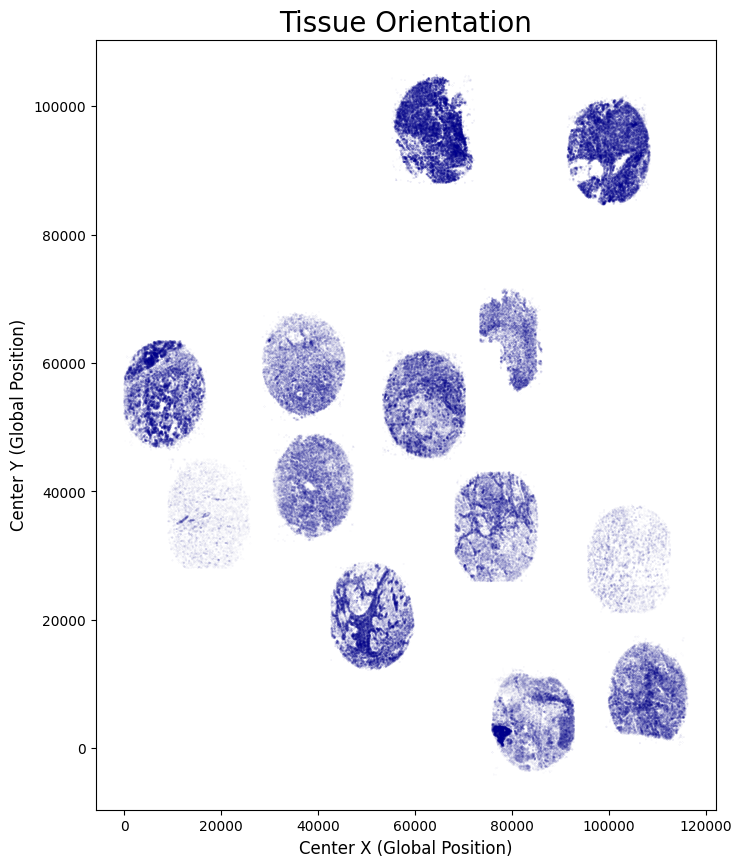

In [119]:
plt.rcParams['figure.figsize'] = [8, 10]
plt.scatter(meta_file["CenterX_global_px"], meta_file["CenterY_global_px"], s=meta_file["Mean.DAPI"]/100000,
            c='darkblue', alpha=0.5)

# Set title and labels
plt.title('Tissue Orientation', size=20)
plt.xlabel('Center X (Global Position)', size=12)
plt.ylabel('Center Y (Global Position)', size=12)


plt.savefig(f'{filepath}initial_tissue_orientation.png')

### FOV overlay allows for tissue section annotation

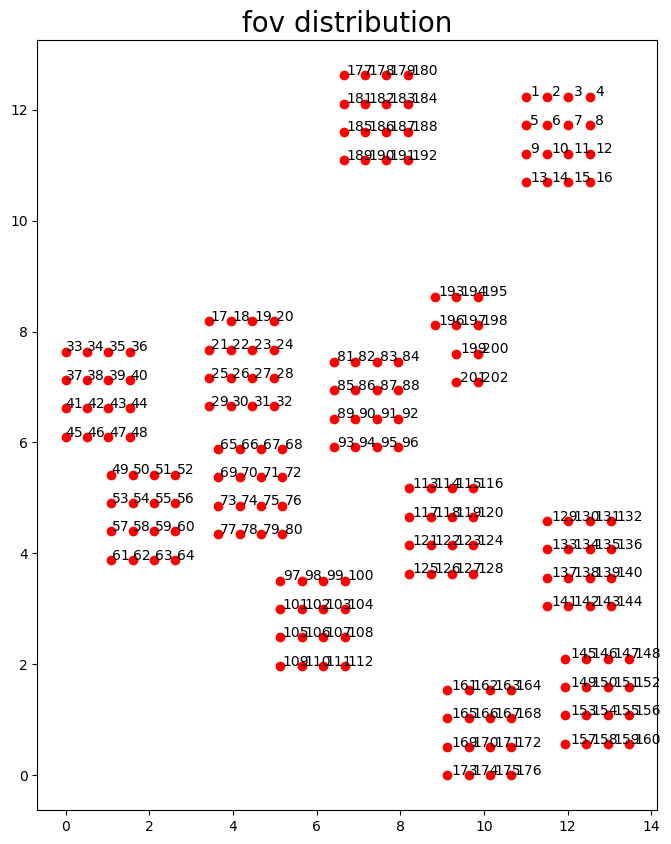

In [24]:
# figure and axes  
fig = plt.figure(figsize=(8,10))
ax = fig.add_subplot(111)

# data
plt.scatter(fov_file["x_global_px"], fov_file["y_global_px"], c="red")
plt.title("fov distribution", size=20)

# annotating each point  
for i, txt in enumerate(fov_file["fov"]):
    ax.text(fov_file["x_global_px"][i]*1.01, fov_file["y_global_px"][i]*1.001, txt)
    
plt.show()

In [25]:
# Transfer correct fov assignments to fov_file
fov_assignment = meta_file[['fov', 'tissue']]

fov_assignment = fov_assignment.drop_duplicates().reset_index() 

In [26]:
fov_assignment

,index,fov,tissue
0,0,1,tissue_01
1,410,2,tissue_01
2,1737,3,tissue_01
3,3154,4,tissue_01
4,3823,5,tissue_01
...,...,...,...
197,185781,198,tissue_13
198,186696,199,tissue_13
199,187409,200,tissue_13
200,188323,201,tissue_13


In [27]:
fov_file = pd.merge(fov_file, fov_assignment, on=['fov'])

del fov_file['index']

In [31]:
fov_file

,fov,x_global_px,y_global_px,tissue
0,1,10.992716,12.230050,tissue_01
1,2,11.504632,12.230050,tissue_01
2,3,12.016547,12.230050,tissue_01
3,4,12.528463,12.230050,tissue_01
4,5,10.992716,11.718135,tissue_01
...,...,...,...,...
197,198,9.845718,8.114066,tissue_13
198,199,9.333802,7.602151,tissue_13
199,200,9.845718,7.602151,tissue_13
200,201,9.333802,7.090235,tissue_13


This information is added for downstream analysis and visualization

In [12]:
# WRONG - do not use
conditions = [
    (fov_file['fov'] <= 16),
    (fov_file['fov'] >= 17) & (fov_file['fov'] <= 32),
    (fov_file['fov'] >= 33) & (fov_file['fov'] <= 48),
    (fov_file['fov'] >= 49) & (fov_file['fov'] <= 64),
    (fov_file['fov'] >= 65) & (fov_file['fov'] <= 80),
    (fov_file['fov'] >= 81) & (fov_file['fov'] <= 96),
    (fov_file['fov'] >= 97) & (fov_file['fov'] <= 112),
    (fov_file['fov'] >= 113) & (fov_file['fov'] <= 128),
    (fov_file['fov'] >= 129) & (fov_file['fov'] <= 144),
    (fov_file['fov'] >= 145) & (fov_file['fov'] <= 160),
    (fov_file['fov'] >= 161) & (fov_file['fov'] <= 176),
    (fov_file['fov'] >= 177) & (fov_file['fov'] <= 192),
    (fov_file['fov'] >= 193) & (fov_file['fov'] <= 202),
    ]

values = ['tissue_01', 'tissue_02', 'tissue_03', 'tissue_04', 'tissue_05',
         'tissue_06', 'tissue_07', 'tissue_08', 'tissue_09', 'tissue_10',
         'tissue_11', 'tissue_12', 'tissue_13', ]

fov_file['tissue'] = np.select(conditions, values)

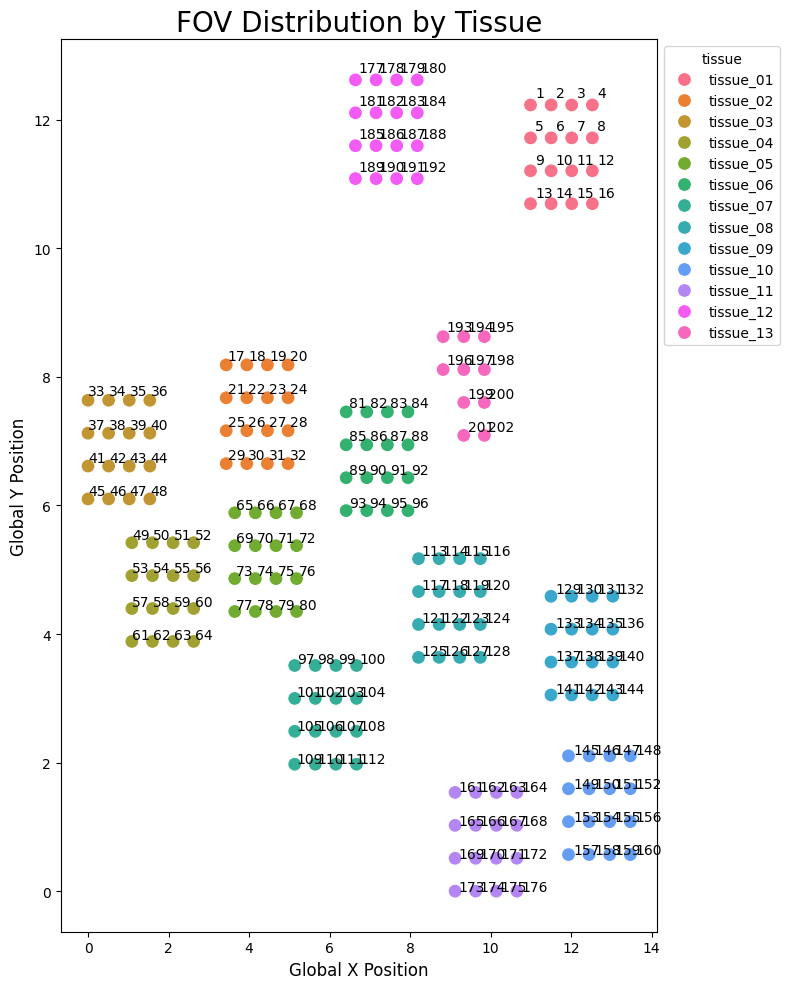

In [32]:
fig = plt.figure(figsize=(8,10))
ax = sns.scatterplot(data=fov_file, x='x_global_px', y='y_global_px', hue='tissue', s=100)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
for i, txt in enumerate(fov_file["fov"]):
    ax.text(fov_file["x_global_px"][i]*1.01, fov_file["y_global_px"][i]*1.01, txt)

# Set title and labels
ax.set_title('FOV Distribution by Tissue', fontsize=20)
ax.set_xlabel('Global X Position', fontsize=12)
ax.set_ylabel('Global Y Position', fontsize=12)

fig.tight_layout()  # Adjust layout to get legend
fig.savefig(f'{filepath}/fov_distribution_by_tissue.png')

In [33]:
# save updated fov_file

fov_file.to_csv("/project/data/gew123/Spatial/input_data/slide_0_fov_positions_updated_tissue.csv")

### Visualizing the number of cells per FOV

Adding tissue information to meta_file in a similar manner as with fov_file

In [40]:
# OLD - new meta file from Yong Shan already has this information

# conditions = [
#     (meta_file['fov'] <= 16),
#     (meta_file['fov'] >= 17) & (meta_file['fov'] <= 32),
#     (meta_file['fov'] >= 33) & (meta_file['fov'] <= 48),
#     (meta_file['fov'] >= 49) & (meta_file['fov'] <= 64),
#     (meta_file['fov'] >= 65) & (meta_file['fov'] <= 80),
#     (meta_file['fov'] >= 81) & (meta_file['fov'] <= 96),
#     (meta_file['fov'] >= 97) & (meta_file['fov'] <= 112),
#     (meta_file['fov'] >= 113) & (meta_file['fov'] <= 128),
#     (meta_file['fov'] >= 129) & (meta_file['fov'] <= 144),
#     (meta_file['fov'] >= 145) & (meta_file['fov'] <= 160),
#     (meta_file['fov'] >= 161) & (meta_file['fov'] <= 176),
#     (meta_file['fov'] >= 177) & (meta_file['fov'] <= 192),
#     (meta_file['fov'] >= 193) & (meta_file['fov'] <= 202),
#     ]

# values = ['tissue_01', 'tissue_02', 'tissue_03', 'tissue_04', 'tissue_05',
#          'tissue_06', 'tissue_07', 'tissue_08', 'tissue_09', 'tissue_10',
#          'tissue_11', 'tissue_12', 'tissue_13', ]

meta_file['tissue'] = np.select(conditions, values)

In [35]:
# crosstabulation of cells per FOV
cells_per_tissue = pd.crosstab(meta_file['fov'], meta_file['tissue'])

In [40]:
cells_per_tissue['cells_per_fov'] = cells_per_tissue['tissue_01'] + cells_per_tissue['tissue_02'] + cells_per_tissue['tissue_03'] + cells_per_tissue['tissue_04'] + cells_per_tissue['tissue_05'] + cells_per_tissue['tissue_06']+ cells_per_tissue['tissue_07']+ cells_per_tissue['tissue_08']+ cells_per_tissue['tissue_09']+ cells_per_tissue['tissue_10']+ cells_per_tissue['tissue_11']+ cells_per_tissue['tissue_12']+ cells_per_tissue['tissue_13']
cells_per_tissue

tissue,tissue_01,tissue_02,tissue_03,tissue_04,tissue_05,tissue_06,tissue_07,tissue_08,tissue_09,tissue_10,tissue_11,tissue_12,tissue_13,cells_per_fov
fov,,,,,,,,,,,,,,
1,410,0,0,0,0,0,0,0,0,0,0,0,0,410
2,1327,0,0,0,0,0,0,0,0,0,0,0,0,1327
3,1417,0,0,0,0,0,0,0,0,0,0,0,0,1417
4,669,0,0,0,0,0,0,0,0,0,0,0,0,669
5,1303,0,0,0,0,0,0,0,0,0,0,0,0,1303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198,0,0,0,0,0,0,0,0,0,0,0,0,915,915
199,0,0,0,0,0,0,0,0,0,0,0,0,713,713
200,0,0,0,0,0,0,0,0,0,0,0,0,914,914


Calculate average cells per sample

In [101]:
cell_counts = cells_per_tissue.sum()

In [102]:
cell_counts = cell_counts.sort_values() # Sort ascending order
cell_counts = cell_counts[:-1] # Remove all tissue total
cell_counts

tissue
tissue_04     5216
tissue_09     5256
tissue_13     7050
tissue_02    11610
tissue_08    15028
tissue_05    15358
tissue_11    16373
tissue_07    16870
tissue_12    17048
tissue_10    17448
tissue_03    18341
tissue_01    20133
tissue_06    23631
dtype: int64

In [42]:
cell_counts.mean()

14566.307692307691

Calculate average FOV per sample

In [106]:
fov_counts = cells_per_tissue.astype(bool).sum(axis=0) # Sum along columns, True = 1

In [107]:
fov_counts = fov_counts[:-1]
fov_counts

tissue
tissue_01    16
tissue_02    16
tissue_03    16
tissue_04    16
tissue_05    16
tissue_06    16
tissue_07    16
tissue_08    16
tissue_09    16
tissue_10    16
tissue_11    16
tissue_12    16
tissue_13    10
dtype: int64

In [108]:
fov_counts.mean()

15.538461538461538

Merging with the fov_file

In [43]:
fov_file = pd.merge(fov_file, cells_per_tissue, on=['fov'])

In [44]:
fov_file

,fov,x_global_px,y_global_px,tissue,tissue_01,tissue_02,tissue_03,tissue_04,tissue_05,tissue_06,tissue_07,tissue_08,tissue_09,tissue_10,tissue_11,tissue_12,tissue_13,cells_per_fov
0,1,10.992716,12.230050,tissue_01,410,0,0,0,0,0,0,0,0,0,0,0,0,410
1,2,11.504632,12.230050,tissue_01,1327,0,0,0,0,0,0,0,0,0,0,0,0,1327
2,3,12.016547,12.230050,tissue_01,1417,0,0,0,0,0,0,0,0,0,0,0,0,1417
3,4,12.528463,12.230050,tissue_01,669,0,0,0,0,0,0,0,0,0,0,0,0,669
4,5,10.992716,11.718135,tissue_01,1303,0,0,0,0,0,0,0,0,0,0,0,0,1303
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197,198,9.845718,8.114066,tissue_13,0,0,0,0,0,0,0,0,0,0,0,0,915,915
198,199,9.333802,7.602151,tissue_13,0,0,0,0,0,0,0,0,0,0,0,0,713,713
199,200,9.845718,7.602151,tissue_13,0,0,0,0,0,0,0,0,0,0,0,0,914,914
200,201,9.333802,7.090235,tissue_13,0,0,0,0,0,0,0,0,0,0,0,0,565,565


Different visualizations of the # of cells per FOV

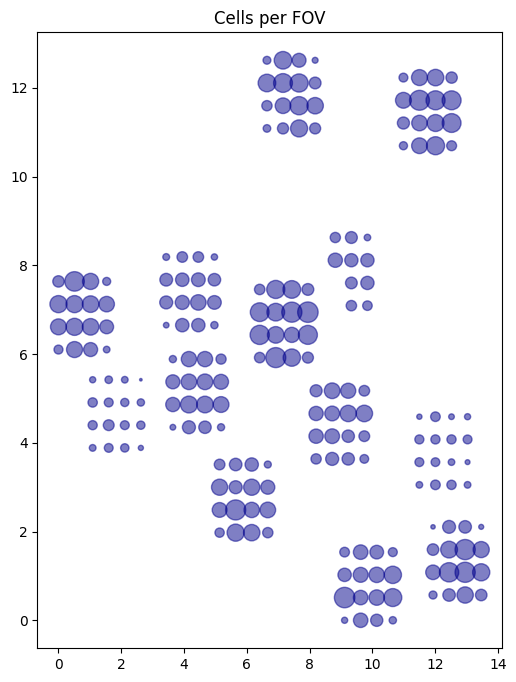

In [62]:
plt.rcParams['figure.figsize'] = [6, 8]
plt.scatter(fov_file["x_global_px"], fov_file["y_global_px"], s=fov_file["cells_per_fov"]/10, c="darkblue", alpha=0.5)
plt.title('Cells per FOV')
plt.savefig(f'{filepath}/cells_per_fov_scatter.png')

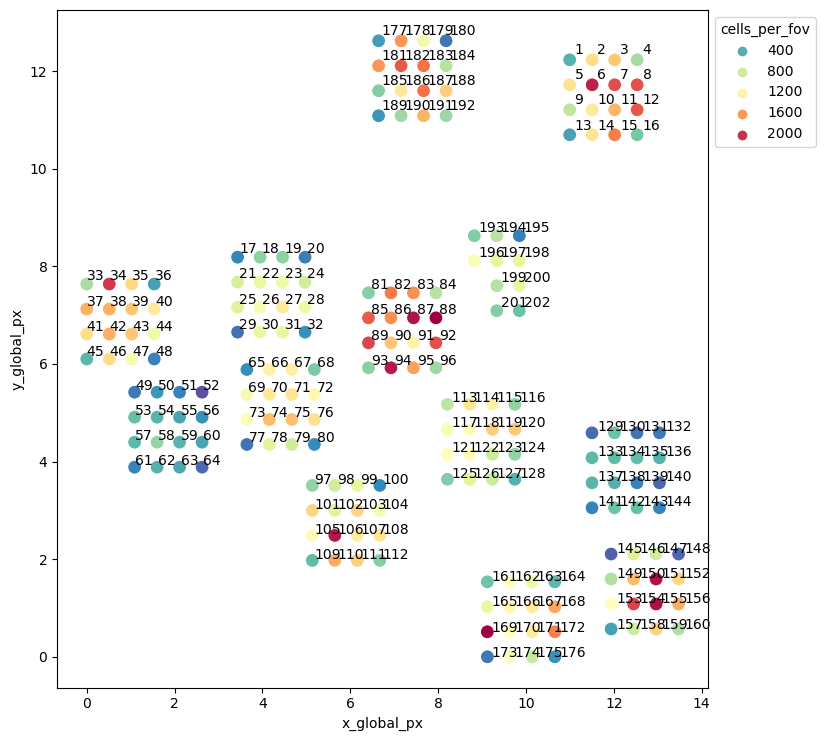

In [32]:
fig = plt.figure(figsize=(6*1.4,8*1.1))
ax = sns.scatterplot(data=fov_file, x='x_global_px', y='y_global_px', hue='cells_per_fov', s=100, palette='Spectral_r')
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
for i, txt in enumerate(fov_file["fov"]):
    ax.text(fov_file["x_global_px"][i]*1.01, fov_file["y_global_px"][i]*1.01, txt)

It seems that the tissues 2 and 4 has highest number of cells per FOV compared to other tissues

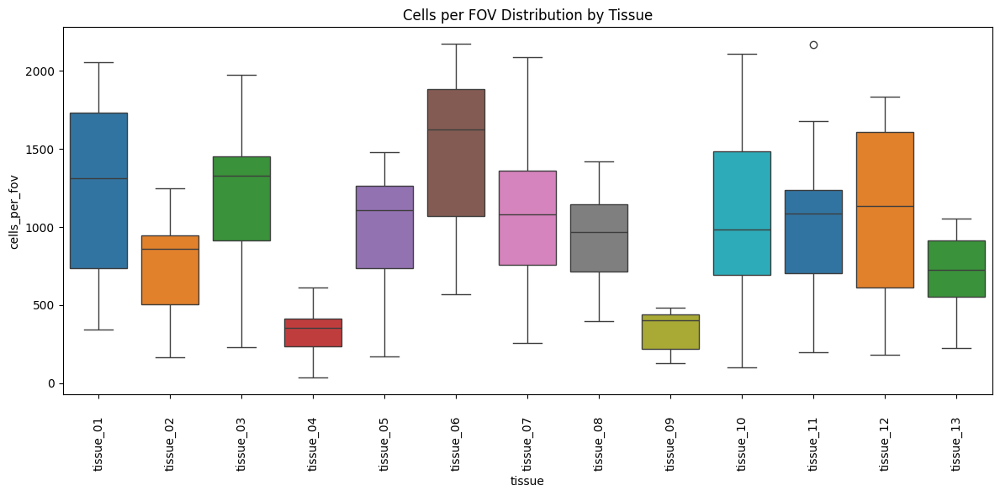

In [103]:
# Adjust the size as necessary for your data
plt.figure(figsize=(12, 6))

# Plot
box = sns.boxplot(x="tissue", y="cells_per_fov",
            hue="tissue", palette="tab10",
            data=fov_file)
#sns.despine(offset=10, trim=True)

# Rotate the x-axis labels to prevent overlap
plt.xticks(rotation=90)

# Increase space between the x-axis and the labels
box.tick_params(axis='x', which='major', pad=15)

# Set title
plt.title('Cells per FOV Distribution by Tissue')

plt.tight_layout()
plt.savefig(f'{filepath}cells_per_fov_boxplot.png')


[Text(0, 0, '1'),
 Text(1, 0, '2'),
 Text(2, 0, '3'),
 Text(3, 0, '4'),
 Text(4, 0, '5'),
 Text(5, 0, '6'),
 Text(6, 0, '7'),
 Text(7, 0, '8'),
 Text(8, 0, '9'),
 Text(9, 0, '10'),
 Text(10, 0, '11'),
 Text(11, 0, '12'),
 Text(12, 0, '13'),
 Text(13, 0, '14'),
 Text(14, 0, '15'),
 Text(15, 0, '16'),
 Text(16, 0, '17'),
 Text(17, 0, '18'),
 Text(18, 0, '19'),
 Text(19, 0, '20'),
 Text(20, 0, '21'),
 Text(21, 0, '22'),
 Text(22, 0, '23'),
 Text(23, 0, '24'),
 Text(24, 0, '25'),
 Text(25, 0, '26'),
 Text(26, 0, '27'),
 Text(27, 0, '28'),
 Text(28, 0, '29'),
 Text(29, 0, '30'),
 Text(30, 0, '31'),
 Text(31, 0, '32'),
 Text(32, 0, '33'),
 Text(33, 0, '34'),
 Text(34, 0, '35'),
 Text(35, 0, '36'),
 Text(36, 0, '37'),
 Text(37, 0, '38'),
 Text(38, 0, '39'),
 Text(39, 0, '40'),
 Text(40, 0, '41'),
 Text(41, 0, '42'),
 Text(42, 0, '43'),
 Text(43, 0, '44'),
 Text(44, 0, '45'),
 Text(45, 0, '46'),
 Text(46, 0, '47'),
 Text(47, 0, '48'),
 Text(48, 0, '49'),
 Text(49, 0, '50'),
 Text(50, 0, '51'),

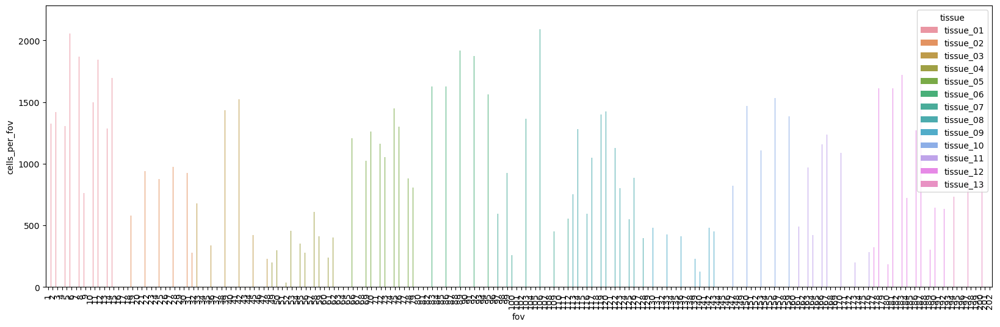

In [34]:
plt.figure(figsize=(20, 6))
my_plot = sns.barplot(x=fov_file['fov'], y=fov_file['cells_per_fov'], hue=fov_file['tissue'])
my_plot.set_xticklabels(my_plot.get_xticklabels(), rotation=90)

Calculate average cells per tissue

In [45]:
meta_file

,fov,cell_ID,Area,AspectRatio,CenterX_local_px,CenterY_local_px,CenterX_global_px,CenterY_global_px,Width,Height,...,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.DAPI,Max.DAPI,tissue,section,subtype,stage
0,1,2,4657,0.95,3644,1488,95035.997899,100191.034702,81,85,...,463,2075,255,1189,114,484,tissue_01,E4,differentiating neuroblastoma,1_2
1,1,3,10996,2.06,3779,1716,95170.997899,99963.034702,183,89,...,37,660,55,3234,138,489,tissue_01,E4,differentiating neuroblastoma,1_2
2,1,4,8122,1.02,3927,1886,95318.997899,99793.034702,103,101,...,474,1335,197,1671,574,1891,tissue_01,E4,differentiating neuroblastoma,1_2
3,1,5,9341,0.82,4077,1919,95468.997899,99760.034702,102,124,...,341,1012,223,2604,514,1377,tissue_01,E4,differentiating neuroblastoma,1_2
4,1,6,4901,1.26,3988,1958,95379.997899,99721.034702,92,73,...,867,1332,220,976,665,1646,tissue_01,E4,differentiating neuroblastoma,1_2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189357,202,471,4170,0.92,111,2728,81967.003876,56219.283252,82,89,...,404,811,330,1782,875,2502,tissue_13,D3,neuroblastoma,4
189358,202,473,4561,1.39,330,2765,82186.003876,56182.283252,97,70,...,511,846,392,1826,1111,3043,tissue_13,D3,neuroblastoma,4
189359,202,474,6188,1.43,238,2809,82094.003876,56138.283252,109,76,...,405,631,307,1721,782,2498,tissue_13,D3,neuroblastoma,4
189360,202,475,4717,1.08,40,2829,81896.003876,56118.283252,81,75,...,438,707,285,1898,971,2498,tissue_13,D3,neuroblastoma,4


Saving meta_file with tissue info for use in squidpy.

In [46]:
meta_file.to_csv("/project/data/gew123/Spatial/input_data/slide_0_metadata_file_updated_tissue_official.csv")

# 02 Squidpy

## Pre-processing

In [ ]:
''' This is where the three flat files - expression matrix, meta data, and fov positions - are combined into a single
    adata object.
    
    The expression matrix contains the gene x cell counts, showing which cells are expressing which genes and how much.
    
    The meta data file provides information on which fov - and therefore which cells - are in which tissue.'''

In [49]:
sample_dir = "/project/data/gew123/Spatial/input/"

adata = sq.read.nanostring(
    path=sample_dir,
    counts_file="slide_0_exprMat_file.csv",
    meta_file="slide_0_metadata_file_updated_tissue_official.csv",
    fov_file="slide_0_fov_positions_updated_tissue.csv",
)
adata

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/squidpy/read/_read.py:225: DtypeWarning: Columns (22) have mixed types. Specify dtype option on import or set low_memory=False.
  obs = pd.read_csv(path / meta_file, header=0, index_col=cell_id_key)
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/anndata/_core/anndata.py:522: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 189362 × 1010
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'tissue', 'section', 'subtype', 'stage', 'cell_ID'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_fov'

In [50]:
adata.obs

,Unnamed: 0,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,...,Max.PanCK,Mean.CD45,Max.CD45,Mean.DAPI,Max.DAPI,tissue,section,subtype,stage,cell_ID
2_1,0,1,4657,0.95,95035.997899,100191.034702,81,85,419,1721,...,2075,255,1189,114,484,tissue_01,E4,differentiating neuroblastoma,1_2,2
3_1,1,1,10996,2.06,95170.997899,99963.034702,183,89,52,4561,...,660,55,3234,138,489,tissue_01,E4,differentiating neuroblastoma,1_2,3
4_1,2,1,8122,1.02,95318.997899,99793.034702,103,101,282,1311,...,1335,197,1671,574,1891,tissue_01,E4,differentiating neuroblastoma,1_2,4
5_1,3,1,9341,0.82,95468.997899,99760.034702,102,124,332,2770,...,1012,223,2604,514,1377,tissue_01,E4,differentiating neuroblastoma,1_2,5
6_1,4,1,4901,1.26,95379.997899,99721.034702,92,73,340,692,...,1332,220,976,665,1646,tissue_01,E4,differentiating neuroblastoma,1_2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471_202,189357,202,4170,0.92,81967.003876,56219.283252,82,89,2288,14766,...,811,330,1782,875,2502,tissue_13,D3,neuroblastoma,4,471
473_202,189358,202,4561,1.39,82186.003876,56182.283252,97,70,3171,17822,...,846,392,1826,1111,3043,tissue_13,D3,neuroblastoma,4,473
474_202,189359,202,6188,1.43,82094.003876,56138.283252,109,76,3346,16071,...,631,307,1721,782,2498,tissue_13,D3,neuroblastoma,4,474
475_202,189360,202,4717,1.08,81896.003876,56118.283252,81,75,2092,13187,...,707,285,1898,971,2498,tissue_13,D3,neuroblastoma,4,475


### QC

Control probes

In [51]:
adata.var["NegPrb"] = adata.var_names.str.startswith("NegPrb")
sc.pp.calculate_qc_metrics(adata, qc_vars=["NegPrb"], inplace=True)

In [52]:
adata

AnnData object with n_obs × n_vars = 189362 × 1010
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'tissue', 'section', 'subtype', 'stage', 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial', 'spatial_fov'

In [53]:
adata.obs['tissue']

2_1        tissue_01
3_1        tissue_01
4_1        tissue_01
5_1        tissue_01
6_1        tissue_01
             ...    
471_202    tissue_13
473_202    tissue_13
474_202    tissue_13
475_202    tissue_13
476_202    tissue_13
Name: tissue, Length: 189362, dtype: object

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


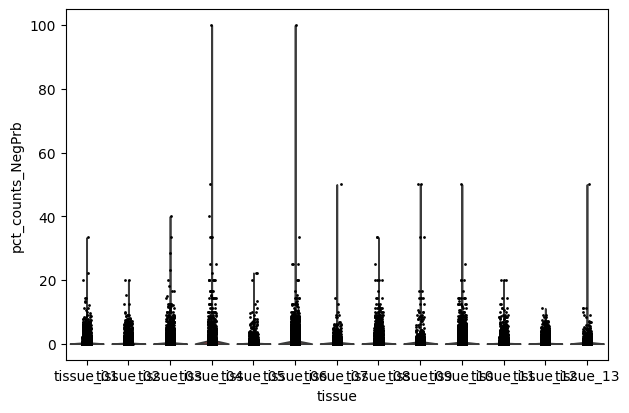

In [54]:
# Adjust the key names as necessary based on how your data is stored
# For example, if `percent_counts_NegPrb` is the calculated percentage of NegPrb stored in adata.obs
# and `tissue` is the column in adata.obs specifying the tissue type
sc.pl.violin(adata, keys='pct_counts_NegPrb', groupby='tissue', size=2, log=False, cut=0)


/tmp/ipykernel_4061130/4117423797.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(x='tissue', y='pct_counts_NegPrb', data=data_to_plot, cut=0,


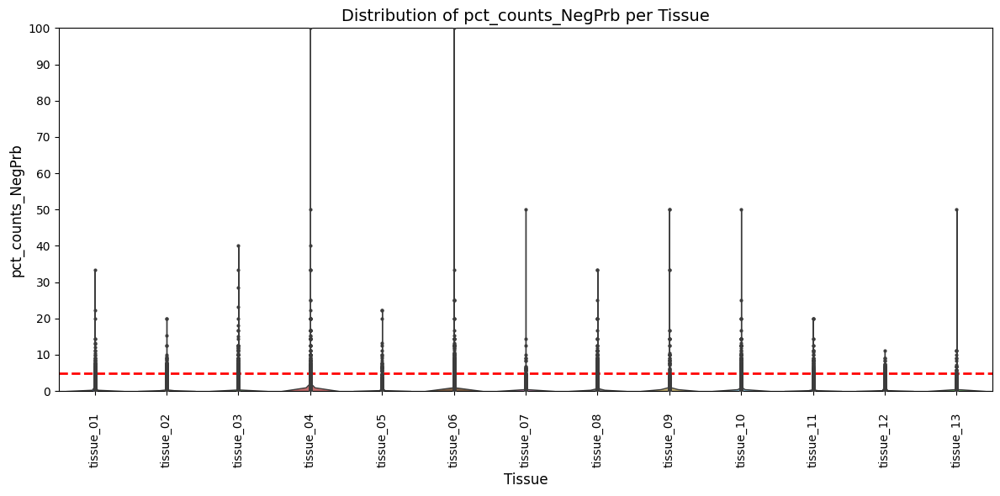

In [55]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming data_to_plot is a Pandas DataFrame with your `adata.obs` data
# with 'tissue' and 'percent_counts_NegPrb' columns
data_to_plot = adata.obs[['tissue', 'pct_counts_NegPrb']]

# Create the violin plot using Seaborn with a larger figure size
plt.figure(figsize=(12, 6))  # Adjust the size as necessary for your data
violin = sns.violinplot(x='tissue', y='pct_counts_NegPrb', data=data_to_plot, cut=0,
                        palette="muted", inner="point", linewidth=1)

# Add the 5% cutoff line
plt.axhline(y=5, color='red', linestyle='--', linewidth=2)

# Customize the plot to achieve a more readable style
violin.set_title('Distribution of pct_counts_NegPrb per Tissue', fontsize=14)
violin.set_xlabel('Tissue', fontsize=12)
violin.set_ylabel('pct_counts_NegPrb', fontsize=12)

# Rotate the x-axis labels to prevent overlap
plt.xticks(rotation=90)

# Adjust the y-axis to have a cleaner look
plt.ylim(0, 100)  # Assuming percent values, adjust as necessary
plt.yticks(range(0, 101, 10))  # Show ticks at every 10%

# Increase space between the x-axis and the labels
violin.tick_params(axis='x', which='major', pad=15)

# Save the figure with high resolution suitable for publication
plt.tight_layout()  # Adjust the layout to fit all elements
#plt.savefig('/mnt/data/better_violin_plot.png', dpi=300)

plt.show()


/tmp/ipykernel_4061130/1812738013.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(x='tissue', y='pct_counts_NegPrb', data=data_to_plot, cut=0,


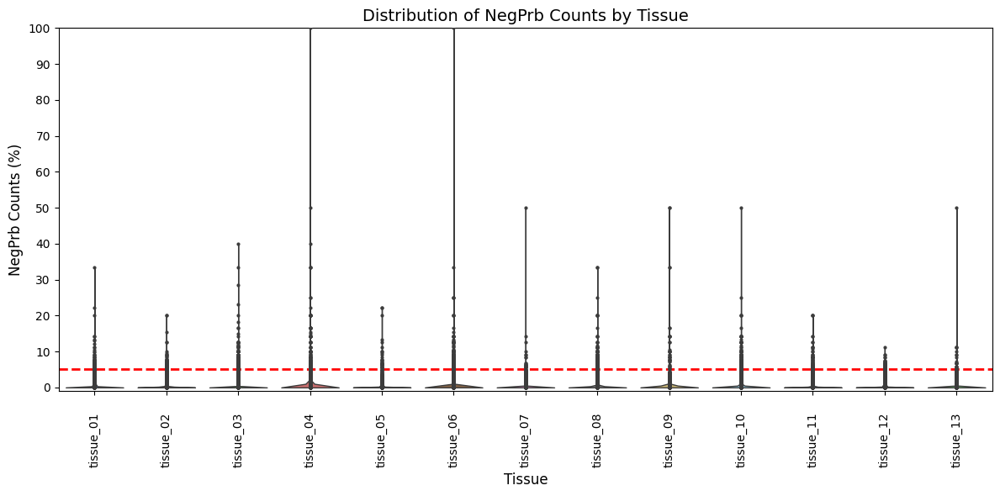

In [56]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming data_to_plot is a Pandas DataFrame with 'tissue' and 'pct_counts_NegPrb' from your adata object
data_to_plot = adata.obs[['tissue', 'pct_counts_NegPrb']]

# Create the violin plot using Seaborn with a larger figure size
plt.figure(figsize=(12, 6))  # Adjust the size as necessary for your data
violin = sns.violinplot(x='tissue', y='pct_counts_NegPrb', data=data_to_plot, cut=0,
                        palette="muted", inner="point", linewidth=1)

# Add the 5% cutoff line
plt.axhline(y=5, color='red', linestyle='--', linewidth=2)

# Customize the plot to achieve a more readable style
violin.set_title('Distribution of NegPrb Counts by Tissue', fontsize=14)
violin.set_xlabel('Tissue', fontsize=12)
violin.set_ylabel('NegPrb Counts (%)', fontsize=12)

# Rotate the x-axis labels to prevent overlap
plt.xticks(rotation=90)

# Adjust the y-axis to start slightly above 0 to raise the violins above the x-axis
plt.ylim(-1, 100)  # Set the lower limit below 0 or to slightly above 0, as preferred
plt.yticks(range(0, 101, 10))  # Show ticks at every 10%

# Increase space between the x-axis and the labels
violin.tick_params(axis='x', which='major', pad=15)

# Save the figure with high resolution suitable for publication
plt.tight_layout()  # Adjust the layout to fit all elements
plt.savefig(f'{filepath}/negprb_percent_counts_violin.png')
plt.show()

In [57]:
pilot_e_montano = adata.obs
pilot_e_montano.to_csv("/project/data/gew123/Spatial/output/spatial_QC_metrics_NEW.csv")

The percentage of unassigned “NegPrb” transcripts

In [58]:
adata.obs["total_counts_NegPrb"].sum() / adata.obs["total_counts"].sum() * 100

0.16579278131745193

### QC metrics for all tissues combined

/tmp/ipykernel_4037445/4293661248.py:10: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  sns.histplot(adata.obs.groupby("fov").sum()["total_counts"],kde=False,ax=axs[2],)


<Axes: title={'center': 'Cell size'}, xlabel='Area', ylabel='Count'>

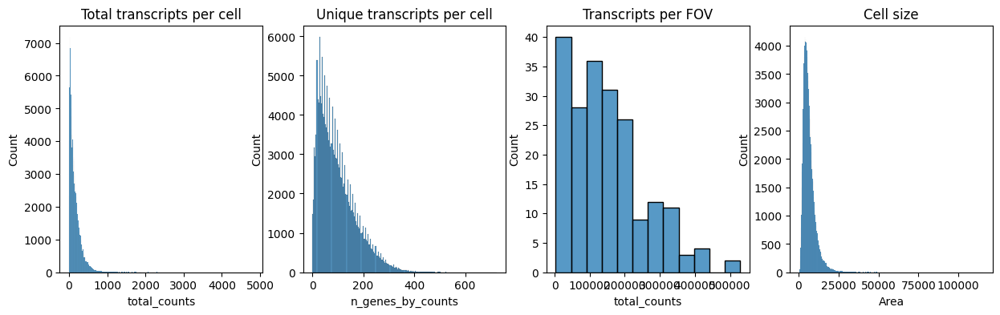

In [119]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))

axs[0].set_title("Total transcripts per cell")
sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0],)

axs[1].set_title("Unique transcripts per cell")
sns.histplot(adata.obs["n_genes_by_counts"],kde=False,ax=axs[1],)

axs[2].set_title("Transcripts per FOV")
sns.histplot(adata.obs.groupby("fov").sum()["total_counts"],kde=False,ax=axs[2],)

axs[3].set_title("Cell size")
sns.histplot(adata.obs["Area"],kde=False,ax=axs[3],)

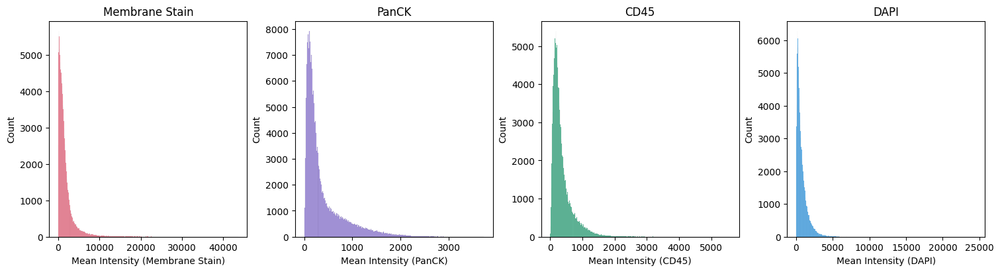

In [59]:
palette = sns.color_palette("husl", 12) 
fig, axs = plt.subplots(1, 4, figsize=(15, 4), layout='constrained')

axs[0].set_title("Membrane Stain")
sns.histplot(adata.obs["Mean.MembraneStain"],kde=False,ax=axs[0], color=palette[0])
axs[0].set_xlabel('Mean Intensity (Membrane Stain)')  # Set custom y-axis label

axs[1].set_title("PanCK")
sns.histplot(adata.obs["Mean.PanCK"],kde=False,ax=axs[1], color=palette[9])
axs[1].set_xlabel('Mean Intensity (PanCK)')  # Set custom y-axis label

axs[2].set_title("CD45")
sns.histplot(adata.obs["Mean.CD45"],kde=False,ax=axs[2], color=palette[5])
axs[2].set_xlabel('Mean Intensity (CD45)')  # Set custom y-axis label

axs[3].set_title("DAPI")
sns.histplot(adata.obs["Mean.DAPI"],kde=False,ax=axs[3], color=palette[8])
axs[3].set_xlabel('Mean Intensity (DAPI)')  # Set custom y-axis label

plt.savefig(f'{filepath}stain_plots.png')                                                   

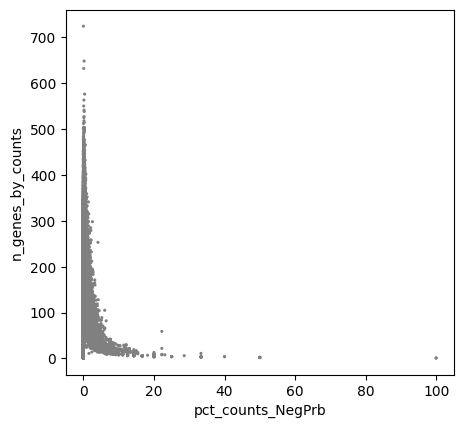

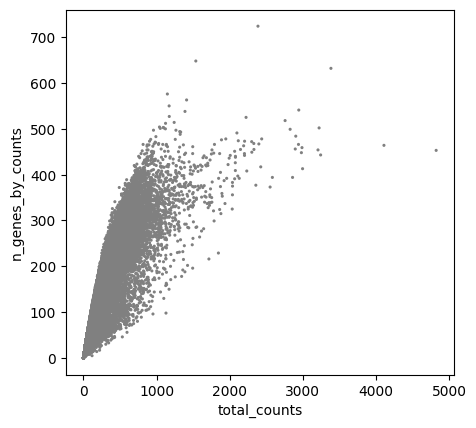

In [190]:
plt.rcParams['figure.figsize'] = [5, 5]
sc.pl.scatter(adata, x='pct_counts_NegPrb', y='n_genes_by_counts', size=20, color='viridis')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', size=20)

/tmp/ipykernel_4061130/850399447.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  violin = sns.violinplot(x='tissue', y='n_genes_by_counts', data=data_to_plot, cut=0,


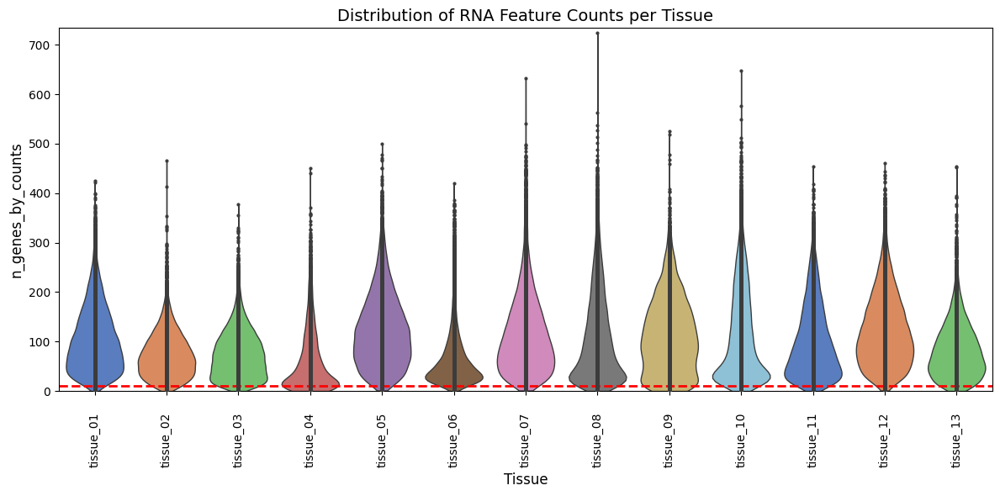

In [60]:
# Assuming we have found or calculated the appropriate column
data_to_plot = adata.obs[['tissue', 'n_genes_by_counts']]

# Create the violin plot using Seaborn with a larger figure size
plt.figure(figsize=(12, 6))
violin = sns.violinplot(x='tissue', y='n_genes_by_counts', data=data_to_plot, cut=0,
                        palette="muted", inner="point", linewidth=1)

# Add the threshold line at 10
plt.axhline(y=10, color='red', linestyle='--', linewidth=2)

# Customize the plot for readability
violin.set_title('Distribution of RNA Feature Counts per Tissue', fontsize=14)
violin.set_xlabel('Tissue', fontsize=12)
violin.set_ylabel('n_genes_by_counts', fontsize=12)

# Rotate the x-axis labels to prevent overlap
plt.xticks(rotation=90)

# Adjust the y-axis as needed
plt.ylim(0, data_to_plot['n_genes_by_counts'].max() + 10)  # Adjust the upper limit as necessary
plt.yticks(range(0, int(data_to_plot['n_genes_by_counts'].max()), 100))  # Adjust step as necessary

# Increase space between the x-axis and the labels
violin.tick_params(axis='x', which='major', pad=15)

# Save the figure with high resolution suitable for publication
plt.tight_layout()
plt.savefig(f'{filepath}feature_violin_plot.png')
plt.show()

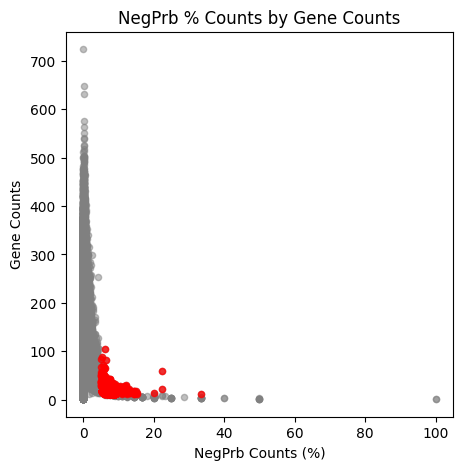

In [198]:
# Conditions for highlighting
condition_negprb = df['pct_counts_NegPrb'] > 5
condition_ngenes = df['n_genes_by_counts'] > 10

# First Plot: pct_counts_NegPrb vs. n_genes_by_counts
plt.figure(figsize=[5, 5])
plt.scatter(df['pct_counts_NegPrb'], df['n_genes_by_counts'], c='grey', alpha=0.5, s=20)  # Base layer
plt.scatter(df[condition_negprb & condition_ngenes]['pct_counts_NegPrb'], 
            df[condition_negprb & condition_ngenes]['n_genes_by_counts'], 
            c='red', alpha=0.75, s=20)  # Highlighted cells
plt.title('NegPrb % Counts by Gene Counts')
plt.xlabel('NegPrb Counts (%)')
plt.ylabel('Gene Counts')

plt.savefig(f'{filepath}/negprb_by_genecount_scatter.png', dpi=400)
plt.show()

Cells with high NegPrb % seem to have lower # of genes. Their distribution seem to be spread through the tissue. Light initial filterning will be applied. Subsequently NegPrb features will be removed from the downstream analysis.  

/tmp/ipykernel_4061130/1567474138.py:26: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('viridis')


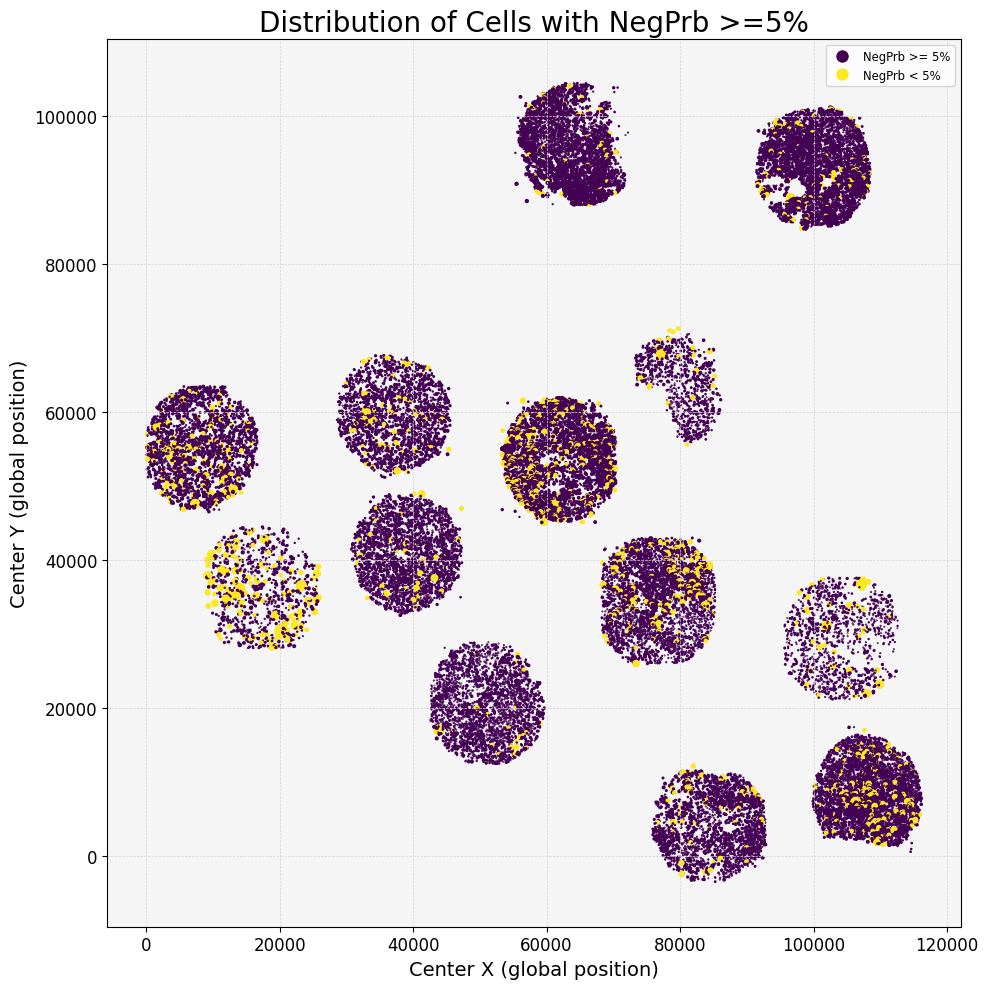

In [61]:
# Retrieving the QC metrics with coordinates of cells
df = adata.obs

# Plotting cells according to the NegPrb >=5 (yellow)  
plt.rcParams['figure.figsize'] = [10, 10]
plt.title("Distribution of cells with NegPrb >=5%")
plt.scatter(df['CenterX_global_px'],
            df['CenterY_global_px'],
            c=df['pct_counts_NegPrb']>=5,
            s=df['pct_counts_NegPrb'],
            cmap='viridis')


# Improving the readability and aesthetics
plt.title("Distribution of Cells with NegPrb >=5%", size=20)
plt.xlabel("Center X (global position)", fontsize=14)
plt.ylabel("Center Y (global position)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Setting a nice background
plt.gca().set_facecolor('whitesmoke')
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='lightgrey')

# Adding a custom legend to explain the color scheme
cmap = plt.cm.get_cmap('viridis')

from matplotlib.lines import Line2D
legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor=cmap(0.0), markersize=10, label='NegPrb >= 5%'),
                   Line2D([0], [0], marker='o', color='w', markerfacecolor=cmap(1.0), markersize=10, label='NegPrb < 5%')]
plt.legend(handles=legend_elements, loc='upper right', fontsize='small')

plt.tight_layout()

plt.savefig(f'{filepath}negprb_distribution_bytissue.png', dpi=400)


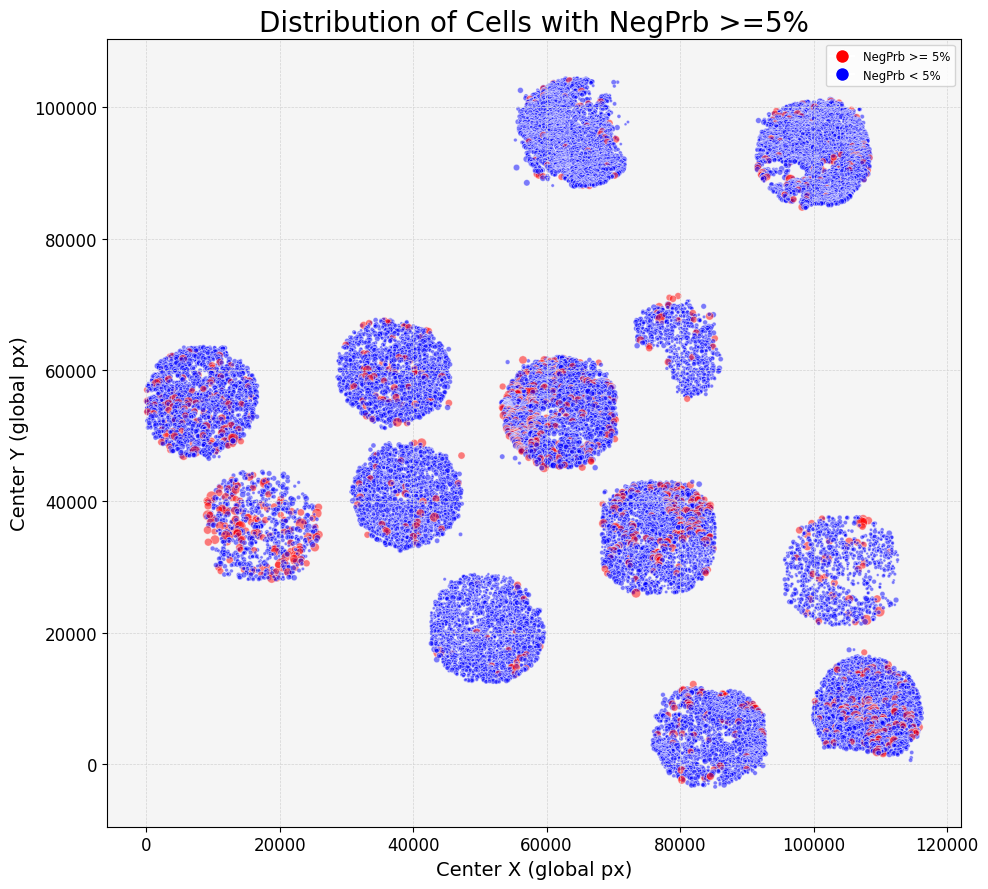

In [206]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

df = adata.obs

# Assuming df is your DataFrame and it's already defined

plt.figure(figsize=(10, 9))

# Define the color map to visually differentiate cells based on NegPrb >= 5%
colors = np.where(df['pct_counts_NegPrb']>=5, 'r', 'b')  # 'r' for True, 'b' for False

# Scatter plot for the distribution of cells
# Adjusting the size ('s') parameter to ensure the plot is readable and visually appealing
scatter = plt.scatter(df['CenterX_global_px'], df['CenterY_global_px'], 
                      c=colors, 
                      s=np.sqrt(df['pct_counts_NegPrb'])*10,  # Adjust size for visibility
                      alpha=0.5,  # Adding some transparency for overlapping points
                      edgecolors='w',  # Adding white edge for better distinction
                      linewidth=0.5)

# Improving the readability and aesthetics
plt.title("Distribution of Cells with NegPrb >=5%", size=20)
plt.xlabel("Center X (global px)", fontsize=14)
plt.ylabel("Center Y (global px)", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Setting a nice background
plt.gca().set_facecolor('whitesmoke')
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='lightgrey')

# Adding a custom legend to explain the color scheme
from matplotlib.lines import Line2D
legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor='r', markersize=10, label='NegPrb >= 5%'),
                   Line2D([0], [0], marker='o', color='w', markerfacecolor='b', markersize=10, label='NegPrb < 5%')]
plt.legend(handles=legend_elements, loc='upper right', fontsize='small')

plt.tight_layout()

# Save the figure with high quality for publication
#plt.savefig('/mnt/data/output/distribution_of_cells_with_NegPrb.png', dpi=300)

plt.show()


In [45]:
plt.rcParams['figure.figsize'] = [6, 6]

### QC metrics for each tissue fragment

In [63]:
# Custom function to plot median and trend
def plot_median(x, **kwargs):
    plt.axvline(x.median(), color="black", ls="--", lw=1)
    plt.text(x.median()+x.median(), 500, "Median = " + str(x.median()))

def plot_trend(x, y, **kwargs):
    slope, intercept = np.polyfit(x, y, 1)
    plt.plot(x, slope * x + intercept, color="red")

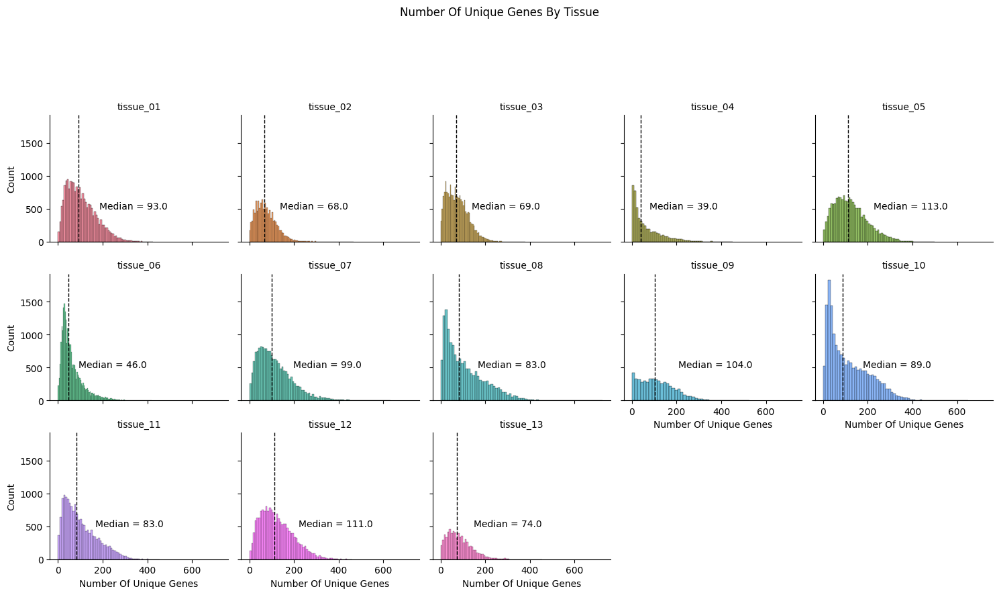

In [64]:
# Plot number of transcripts by tissue
plot=sns.FacetGrid(data=adata.obs, col="tissue", hue="tissue", sharex=True, sharey=True, col_wrap=5)

plot.map(sns.histplot, "n_genes_by_counts")
plot.map(plot_median,'n_genes_by_counts')

plot.set_titles("{col_name}")
plot.set_axis_labels("Number Of Unique Genes")

plot.fig.subplots_adjust(top=0.8)
plot.fig.suptitle("Number Of Unique Genes By Tissue")

plt.savefig(f'{filepath}unique_genes_per_tissue.png', dpi=400)
plt.show()

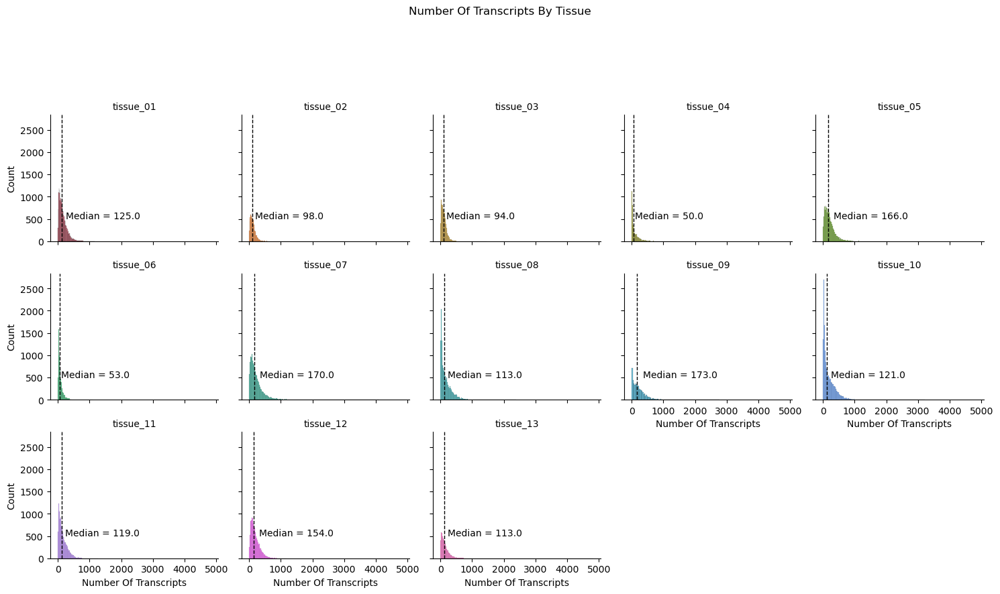

In [48]:
# Plot number of transcripts by tissue
plot=sns.FacetGrid(data=adata.obs, col="tissue", hue="tissue", sharex=True, sharey=True, col_wrap=5)

plot.map(sns.histplot, "total_counts")
plot.map(plot_median,'total_counts')

plot.set_titles("{col_name}")
plot.set_axis_labels("Number Of Transcripts")

plot.fig.subplots_adjust(top=0.8)
plot.fig.suptitle("Number Of Transcripts By Tissue")

plt.show()

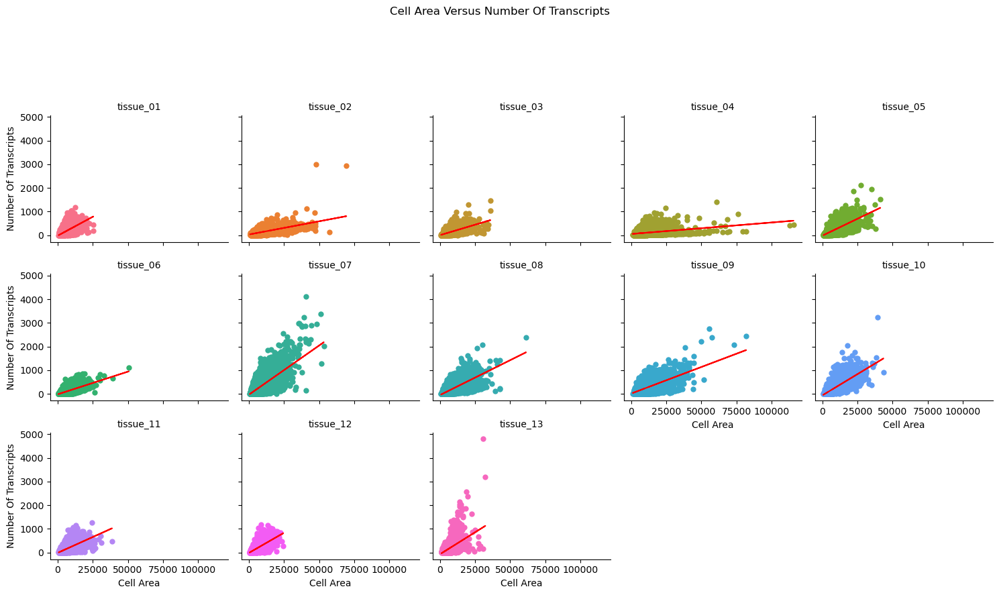

In [49]:
#Plot relationship between cell area and number of transcripts
plot=sns.FacetGrid(data=adata.obs, col="tissue", hue="tissue", sharex=True, sharey=True, col_wrap=5)

plot.map(sns.scatterplot, "Area", "total_counts", linewidth = 0)
plot.map(plot_trend, "Area", "total_counts")

plot.set_titles("{col_name}")
plot.set_axis_labels("Cell Area", "Number Of Transcripts")

plot.fig.subplots_adjust(top=0.8)
plot.fig.suptitle("Cell Area Versus Number Of Transcripts")

plt.show()

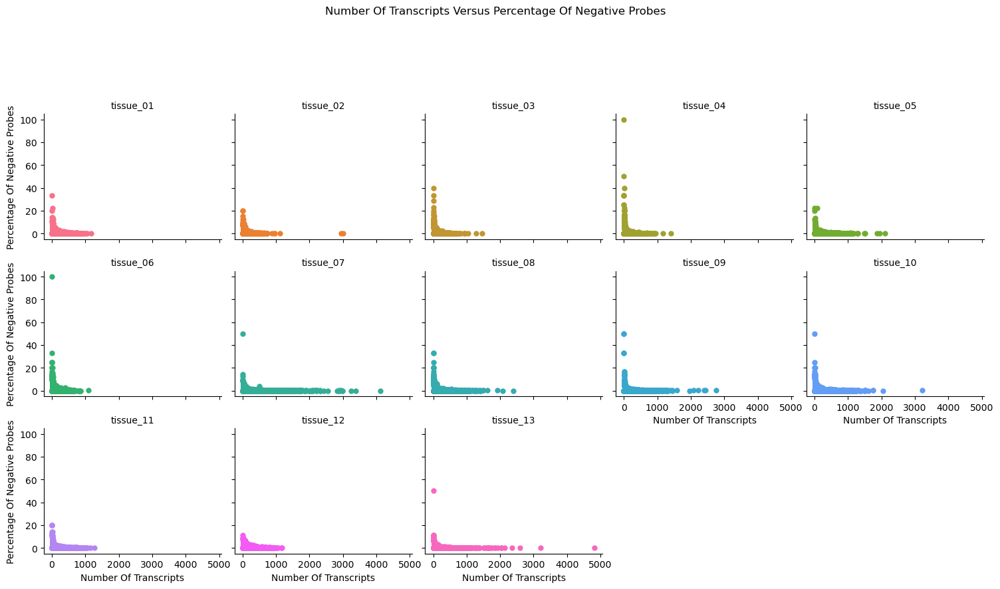

In [50]:
# Plot relationship between percentage of negative probes and number of transcripts
plot=sns.FacetGrid(data=adata.obs, col="tissue", hue="tissue", sharex=True, sharey=True, col_wrap=5)

plot.map(sns.scatterplot, "total_counts", "pct_counts_NegPrb", linewidth = 0)
#plot.map(plot_trend, "total_counts", "pct_counts_NegPrb")

plot.set_titles("{col_name}")
plot.set_axis_labels("Number Of Transcripts", "Percentage Of Negative Probes")

plot.fig.subplots_adjust(top=0.8)
plot.fig.suptitle("Number Of Transcripts Versus Percentage Of Negative Probes")

plt.show()

### Combined filtering using all tissues 

QC data suggest that most of the cells have up to 400 genes and 1000 transcipts. There is a difference beetween tissues, which may be technical/biological. The percentage of NegPrb seems to be generally very low <5% and seems to be distributed through the tissue.  
Filtering to keep cells/genes:   
* cells with minimal number of genes (at least 10)  
* removal of cell with high % of NegPrb (>=5%)

Before filtering data has 115795 cells:

In [232]:
adata.shape[0]

189362

Fraction of counts assigned to each gene over all cells before filtering

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:196: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))


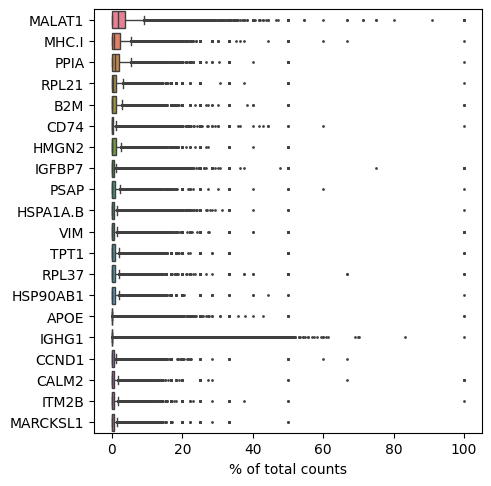

In [241]:
sc.settings.figdir = '/project/data/gew123/Spatial/plots'

sc.pl.highest_expr_genes(adata, n_top=20, save='degs_pre_filtering.png')

Looking at the distibution of unique genes found per cell and

In [65]:
adata.obs["n_genes_by_counts"].describe()

count    189362.000000
mean         97.669559
std          72.632274
min           0.000000
25%          41.000000
50%          81.000000
75%         137.000000
max         724.000000
Name: n_genes_by_counts, dtype: float64

In [66]:
adata.obs["pct_counts_NegPrb"].describe()

count    189331.000000
mean          0.258964
std           1.036700
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         100.000000
Name: pct_counts_NegPrb, dtype: float64

Data filtering

In [67]:
sc.pp.filter_cells(adata, min_genes=10)
adata

AnnData object with n_obs × n_vars = 183795 × 1010
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'tissue', 'section', 'subtype', 'stage', 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial', 'tissue_colors'
    obsm: 'spatial', 'spatial_fov'

In [56]:
# sc.pp.filter_genes(adata, min_cells=189362*0.01) # at least 1% of cells
# adata

In [68]:
adata = adata[adata.obs.pct_counts_NegPrb <= 5, :]
adata

View of AnnData object with n_obs × n_vars = 182735 × 1010
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'tissue', 'section', 'subtype', 'stage', 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial', 'tissue_colors'
    obsm: 'spatial', 'spatial_fov'

In [69]:
adata

View of AnnData object with n_obs × n_vars = 182735 × 1010
    obs: 'Unnamed: 0', 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'tissue', 'section', 'subtype', 'stage', 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial', 'tissue_colors'
    obsm: 'spatial', 'spatial_fov'

### QC metrics after filtering

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


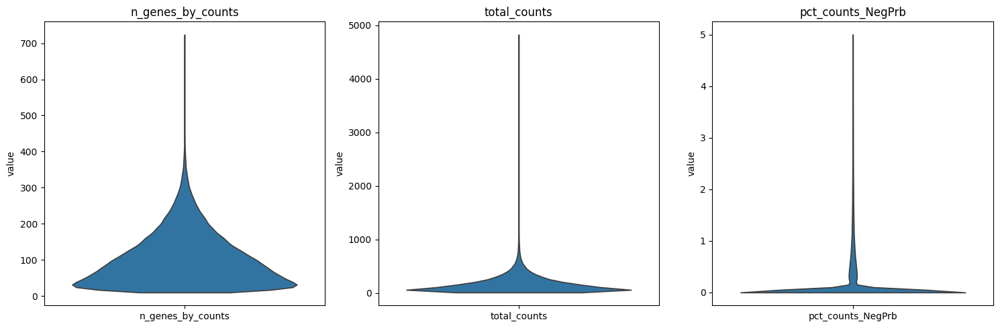

In [70]:
# Define the features you want to plot
features = ['n_genes_by_counts', 'total_counts', 'pct_counts_NegPrb']

# Number of features
n_features = len(features)

# Create subplots
fig, axs = plt.subplots(1, n_features, figsize=(15, 5))

# Plot each feature in a separate subplot
for i, feature in enumerate(features):
    sc.pl.violin(adata, keys=feature, jitter=0.4, size=0, ax=axs[i], show=False)
    axs[i].set_title(feature)

# Adjust layout
plt.tight_layout()

# Save the figure
plt.savefig(f'{filepath}/post_filtering_plots.png')

plt.show()


The list of 20 genes looks different after filtering

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


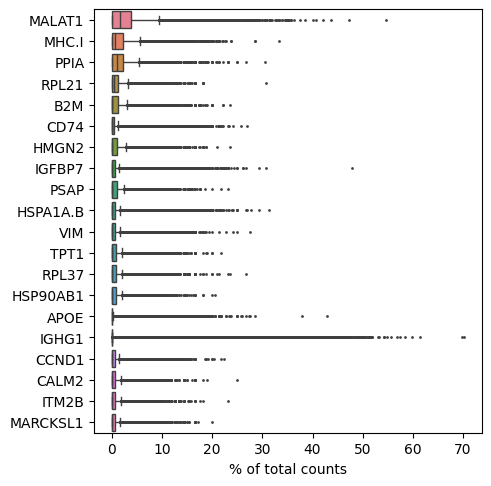

In [247]:
sc.pl.highest_expr_genes(adata, n_top=20, )

Approx 2% of cells are removed

In [71]:
# number of filtered out cells  
(189362 - 182735)/189362 * 100

3.499646180331851

Removing NegPrb features from the feature list as they are not genes and may affect downstream analysis.  

In [72]:
# before  
adata.var["NegPrb"]

AATK       False
ABL1       False
ABL2       False
ACACB      False
ACE        False
           ...  
NegPrb5     True
NegPrb6     True
NegPrb7     True
NegPrb8     True
NegPrb9     True
Name: NegPrb, Length: 1010, dtype: bool

In [73]:
adata=adata[:, adata.var["NegPrb"]==False]

In [74]:
# after  
adata.var["NegPrb"]

AATK      False
ABL1      False
ABL2      False
ACACB     False
ACE       False
          ...  
XKR4      False
YBX3      False
YES1      False
ZBTB16    False
ZFP36     False
Name: NegPrb, Length: 1000, dtype: bool

Saving results

In [79]:
adata.obs

,Unnamed: 0,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,...,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_genes
3_1,1,1,10996,2.06,95170.997899,99963.034702,183,89,52,4561,...,92,4.532599,72.826087,100.000000,100.0,100.0,0,0.000000,0.000000,75
5_1,3,1,9341,0.82,95468.997899,99760.034702,102,124,332,2770,...,48,3.891820,100.000000,100.000000,100.0,100.0,1,0.693147,2.083333,36
6_1,4,1,4901,1.26,95379.997899,99721.034702,92,73,340,692,...,83,4.430817,100.000000,100.000000,100.0,100.0,0,0.000000,0.000000,43
7_1,5,1,8042,0.76,95249.997899,99688.034702,93,123,380,1287,...,12,2.564949,100.000000,100.000000,100.0,100.0,0,0.000000,0.000000,11
8_1,6,1,3137,0.72,95412.997899,99681.034702,63,87,569,1201,...,44,3.806662,100.000000,100.000000,100.0,100.0,0,0.000000,0.000000,34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471_202,189357,202,4170,0.92,81967.003876,56219.283252,82,89,2288,14766,...,86,4.465908,79.069767,100.000000,100.0,100.0,0,0.000000,0.000000,68
473_202,189358,202,4561,1.39,82186.003876,56182.283252,97,70,3171,17822,...,170,5.141664,68.823529,98.235294,100.0,100.0,0,0.000000,0.000000,103
474_202,189359,202,6188,1.43,82094.003876,56138.283252,109,76,3346,16071,...,95,4.564348,89.473684,100.000000,100.0,100.0,0,0.000000,0.000000,60
475_202,189360,202,4717,1.08,81896.003876,56118.283252,81,75,2092,13187,...,91,4.521789,83.516484,100.000000,100.0,100.0,0,0.000000,0.000000,65


In [ ]:
if 'stage' in adata.obs:
    adata.obs['stage'] = str(adata.obs['stage'])

In [119]:
dir = '/project/data/gew123/Spatial'

adata.write(f'{dir}/output/slide0_all_tissues_post_QC_no_NegPrb_NEW.h5ad')

In [50]:
# Checkpoint - read in adata
adata = sc.read_h5ad(f'{dir}/output/slide0_all_tissues_post_QC_no_NegPrb_NEW.h5ad')

## PCA/normalizations

Prinicipal Component Analysis

In [120]:
adata.layers["counts"] = adata.X.copy()
sc.pp.normalize_total(adata, inplace=True)
sc.pp.log1p(adata)
sc.pp.pca(adata)

The elbow of the elbow plot seems to be around 26 PCs. The data contains heterogenous population of cells, thus potentially higher number of PCs may be beneficial.  

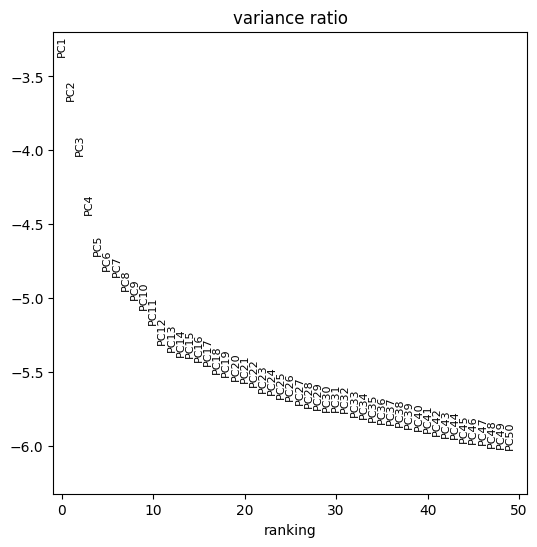

In [127]:
plt.rcParams['figure.figsize'] = [6, 6]
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

In [128]:
# Ensure PCA has been run, variance ratios should be in adata.uns['pca']
variance_ratios = adata.uns['pca']['variance_ratio'][:50]


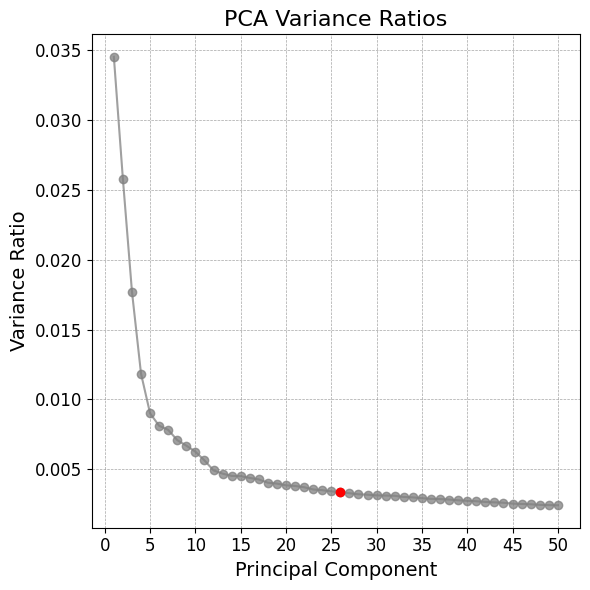

In [129]:
import matplotlib.pyplot as plt

# Set figure size
plt.figure(figsize=[6, 6])

# Plot the variance ratios for the first 50 PCs
plt.plot(range(1, 51), variance_ratios, marker='o', linestyle='-', color='grey', alpha=0.75)

# Highlight PC26
plt.plot(26, variance_ratios[25], 'ro')  # 'ro' creates a red circle at PC26

# Add enhancements for publication quality
plt.title('PCA Variance Ratios', fontsize=16)
plt.xlabel('Principal Component', fontsize=14)
plt.ylabel('Variance Ratio', fontsize=14)
plt.xticks(ticks=range(0, 51, 5), fontsize=12)  # Show labels for every 5th PC
plt.yticks(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='grey', alpha=0.7)

# Show plot
plt.tight_layout()  # Adjust the layout to make room for the plot elements
plt.savefig(f'{filepath}pca_variance_ratios.png')
plt.show()

In [130]:
variance_ratios

array([0.03452504, 0.02576172, 0.01771122, 0.01184153, 0.00900039,
       0.00811555, 0.00782267, 0.00708835, 0.00669316, 0.00626326,
       0.00563755, 0.00492496, 0.00469097, 0.00453049, 0.00451215,
       0.00438457, 0.00427503, 0.00404113, 0.00397816, 0.00385501,
       0.00380871, 0.00371994, 0.00355939, 0.00351074, 0.00341919,
       0.00337587, 0.00328926, 0.00321352, 0.00318382, 0.00313397,
       0.00312306, 0.00310583, 0.00301846, 0.00299215, 0.00293446,
       0.00288559, 0.00287072, 0.00283752, 0.00278591, 0.00274785,
       0.00271589, 0.00266488, 0.00263485, 0.00260853, 0.00254636,
       0.00251902, 0.00249888, 0.00245652, 0.00243948, 0.00242556])

In [131]:
variance_ratios

array([0.03452504, 0.02576172, 0.01771122, 0.01184153, 0.00900039,
       0.00811555, 0.00782267, 0.00708835, 0.00669316, 0.00626326,
       0.00563755, 0.00492496, 0.00469097, 0.00453049, 0.00451215,
       0.00438457, 0.00427503, 0.00404113, 0.00397816, 0.00385501,
       0.00380871, 0.00371994, 0.00355939, 0.00351074, 0.00341919,
       0.00337587, 0.00328926, 0.00321352, 0.00318382, 0.00313397,
       0.00312306, 0.00310583, 0.00301846, 0.00299215, 0.00293446,
       0.00288559, 0.00287072, 0.00283752, 0.00278591, 0.00274785,
       0.00271589, 0.00266488, 0.00263485, 0.00260853, 0.00254636,
       0.00251902, 0.00249888, 0.00245652, 0.00243948, 0.00242556])

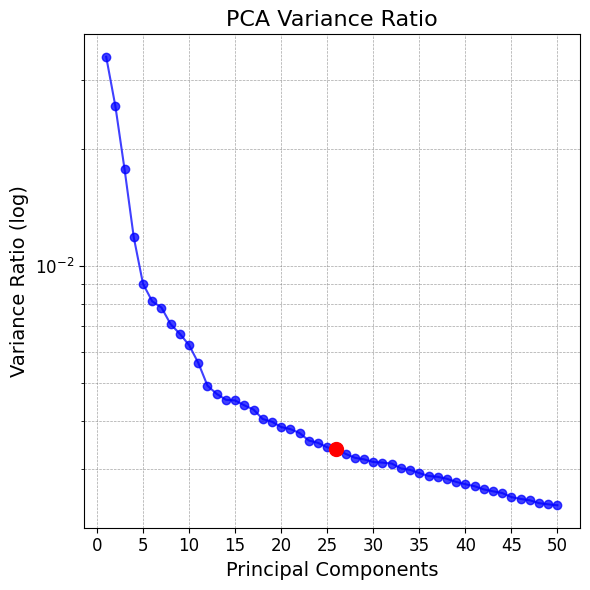

In [132]:
import matplotlib.pyplot as plt
import numpy as np

# Extract the PCA variance ratios from the adata object, assuming it's stored in a standard location.
# For the demonstration, let's generate a mock variance_ratio array similar to what you'd find in your adata object.
# Replace this line with your actual data extraction.
#variance_ratios = np.sort(np.random.rand(50))[::-1]  # Assuming descending variance ratios for demonstration
variance_ratios = adata.uns['pca']['variance_ratio'][:50]

# Create the elbow plot
plt.figure(figsize=(6, 6))
pc_numbers = np.arange(len(variance_ratios)) + 1  # PC numbers (1-based indexing)

# Plot all PCs in a default color
plt.plot(pc_numbers, variance_ratios, marker='o', linestyle='-', color='blue', alpha=0.75)

# Highlight PC26 in red
plt.plot(pc_numbers[25], variance_ratios[25], marker='o', linestyle='', color='red', markersize=10)

# Set log scale for the y-axis
plt.yscale('log')

# Enhancements for readability and aesthetics
plt.title('PCA Variance Ratio', fontsize=16)
plt.xlabel('Principal Components', fontsize=14)
plt.ylabel('Variance Ratio (log)', fontsize=14)
plt.xticks(ticks=np.arange(0, 51, 5), fontsize=12)  # Adjust ticks as needed
plt.yticks(fontsize=12)
plt.grid(True, which='both', linestyle='--', linewidth=0.5, color='grey', alpha=0.7)

plt.tight_layout()
plt.show()


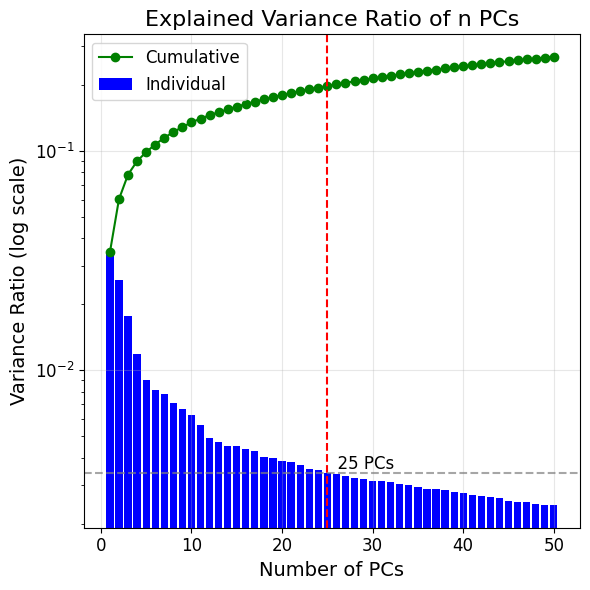

In [133]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming variance_ratio contains the PCA variance ratios, 
# you can typically extract this from your adata object, e.g.:
# variance_ratio = adata.uns['pca']['variance_ratios'][:50] if it's stored there,
# or you've previously calculated it to include in the plot.

# For demonstration, let's simulate some data:
#variance_ratio = np.sort(np.random.rand(50))[::-1]  # Sort to simulate descending variance ratios
variance_ratio = adata.uns['pca']['variance_ratio'][:50]


# Calculate cumulative variance explained for better insight
cumulative_variance = np.cumsum(variance_ratio)

# Creating the elbow plot
plt.figure(figsize=(6, 6))
#plt.plot(range(1, 51), variance_ratio, 'o-', color='darkblue', label='Individual')
plt.bar(range(1, 51), variance_ratio, color='blue', label='Individual')
plt.plot(range(1, 51), cumulative_variance, 'o-', color='green', label='Cumulative')

# Enhancements for publication quality
plt.title('Explained Variance Ratio of n PCs', fontsize=16)
plt.xlabel('Number of PCs', fontsize=14)
plt.ylabel('Variance Ratio (log scale)', fontsize=14)
plt.yscale('log')  # Logarithmic scale for the y-axis
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(fontsize=12)
plt.grid(True, alpha=0.3)  # Grid with transparency for less obstruction

# Optional: Highlight the elbow point - adjust based on your analysis
elbow_point = 25 # Example point where you decide the elbow is
plt.axvline(x=elbow_point, linestyle='--', color='red', label='Elbow Point')
plt.axhline(y=variance_ratio[elbow_point-1], linestyle='--', color='grey', alpha=0.7)
plt.text(elbow_point, variance_ratio[elbow_point-1], f'  {elbow_point} PCs', verticalalignment='bottom', fontsize=12)

plt.tight_layout()  # Adjusts subplots to fit into the figure area.
plt.savefig(f'{filepath}pca_variance_elbow_plot.png', dpi=400)
plt.show()


PCA plots showing the tissue, log1 values of genes and counts across first 4 PCs.  

In [69]:
# Test
pca_original = adata.obsm['X_pca']

pca_components = adata.obsm['X_pca']
pca_components[:, 0] = -pca_components[:, 0]
#pca_components[:, 1] = -pca_components[:, 1]

adata.obsm['X_pca'] = pca_components

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


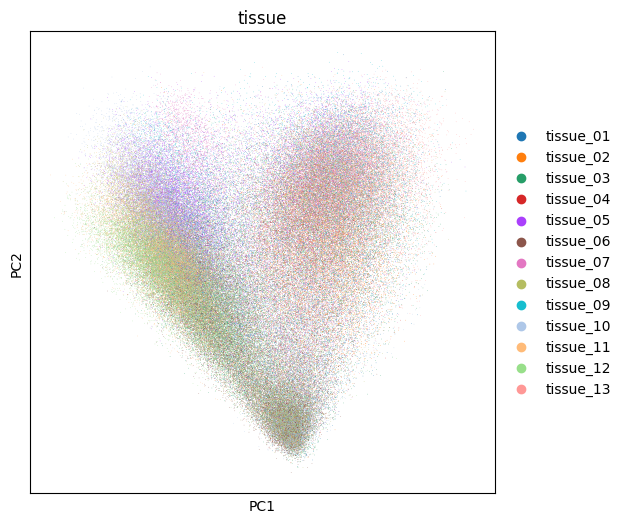

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


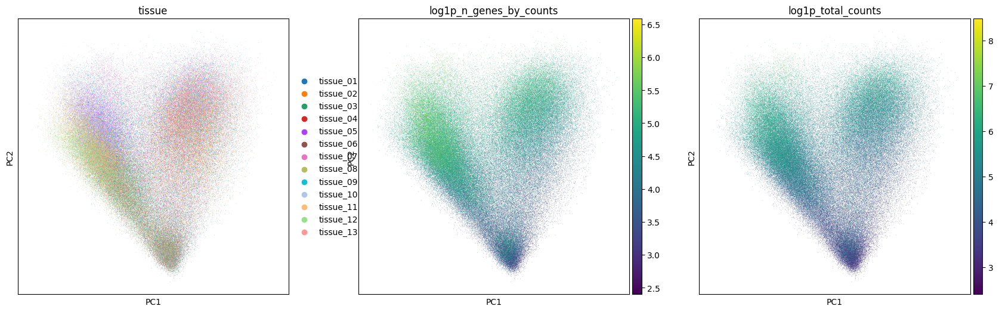

In [64]:
sc.pl.pca(adata, color=['tissue', 'log1p_n_genes_by_counts', 'log1p_total_counts'], components=['1,2'])
plt.tight_layout()

Calculating neighbours 

In [134]:
# Running at all PCs
sc.pp.neighbors(adata, n_pcs=25)

Calculating UMAP  

In [135]:
sc.tl.umap(adata)

Identifying communities using leiden. Using default resolution (1.0) for initial combined analysis.

In [142]:
sc.tl.leiden(adata, resolution=1.0, key_added='leiden_25_1.0') # Could change resolution

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


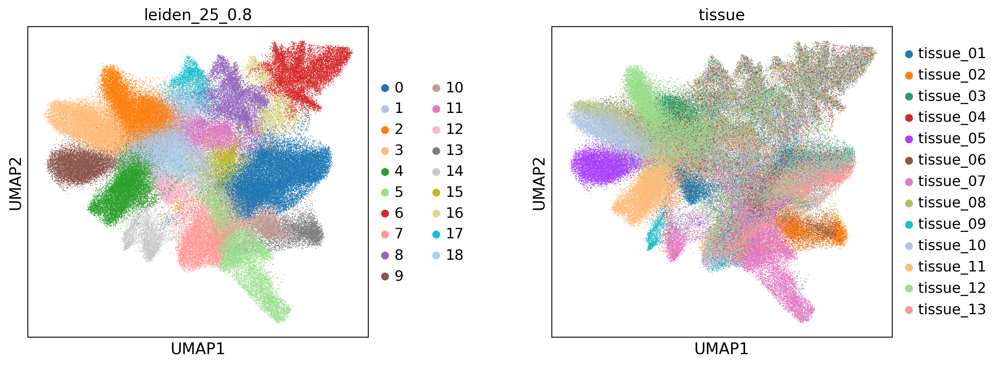

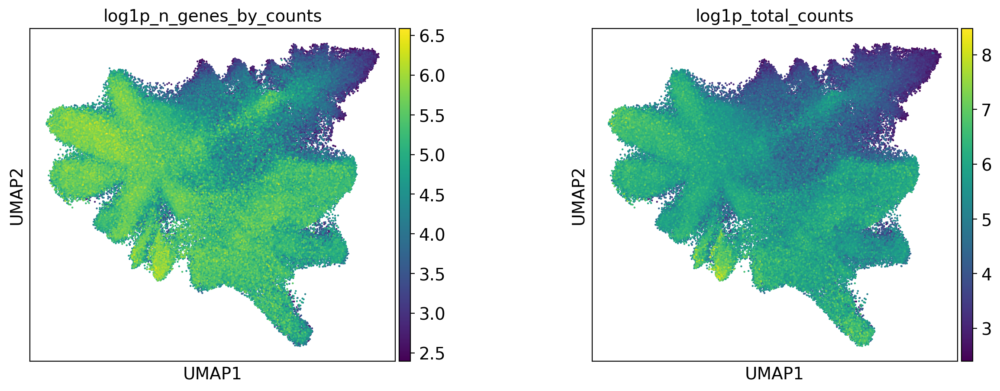

In [184]:
# Plot
sc.set_figure_params(dpi=100, dpi_save=400, figsize=(5,5))

res = 0.8

sc.pl.umap(adata, color=[f'leiden_25_{res}', 'tissue'], size=2, wspace=0.4, save=f'_25_{res}.png')
sc.pl.umap(adata, color=['log1p_n_genes_by_counts', 'log1p_total_counts', ], size=10, wspace=0.4, save=f'_25_{res}_counts_distribution.png')

Determine best clustering resolution by ASW score

In [186]:
adata.obsm

AxisArrays with keys: spatial, spatial_fov, X_pca, X_umap

In [189]:
print(f'Calculating ASW scores for each resolution...')

scores = {}
labels = ['leiden_25_0.7', 'leiden_25_0.8', 'leiden_25_1.0']

for i in labels:
    print(f'Calculating ASW for {i}')
    assignments = adata.obs[i]
    # Calculate score based on X_scvi representation
    asw_score = silhouette_score(adata.obsm['X_umap'], assignments)
    scores[i] = asw_score
    print(asw_score)

print(scores)

Calculating ASW scores for each resolution...
Calculating ASW for leiden_25_0.7
0.17185266
Calculating ASW for leiden_25_0.8
0.16257845
Calculating ASW for leiden_25_1.0
0.16097766
{'leiden_25_0.7': 0.17185266, 'leiden_25_0.8': 0.16257845, 'leiden_25_1.0': 0.16097766}


In [190]:
# Save progress
adata.write('/project/data/gew123/Spatial/Objects/spatial_clustered_unlabelled.h5ad')

## Analysis

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


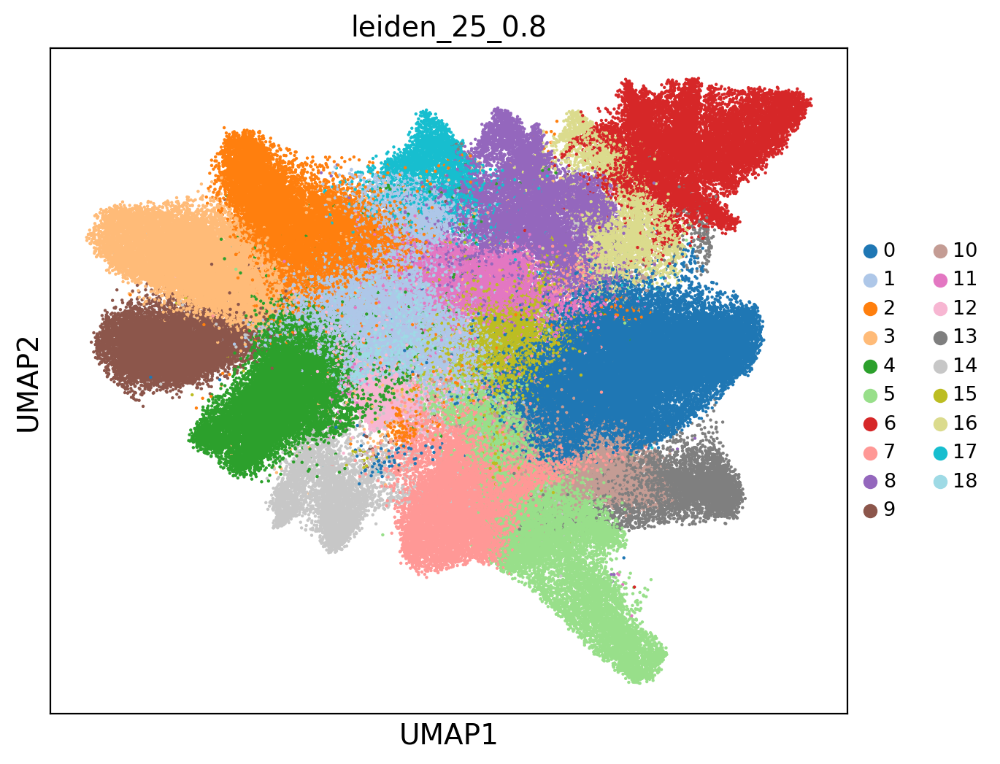

In [183]:
sc.set_figure_params(dpi=100, dpi_save=400, figsize=(7,6))
sc.settings.figdir = '/project/data/gew123/Spatial/plots'

sc.pl.umap(adata, color=['leiden_25_0.8'], size=10, wspace=0.4,
           #legend_loc='on data',
           legend_fontsize='x-small',
           palette='tab20',
           #add_outline=True,
           #outline_color=('white', 'black'), 
        save='final_clusters_no_outline.png')

There seem to be separation between tissue_01 and other tissues. Tissue_01 contains most of the cell in the data.  

In [198]:
adata.obs['tissue'].value_counts().sort_values()

tissue_04     4272
tissue_09     4916
tissue_13     6763
tissue_02    11205
tissue_08    14374
tissue_05    15149
tissue_11    15893
tissue_07    16542
tissue_12    16847
tissue_10    16872
tissue_03    17546
tissue_01    19797
tissue_06    22559
Name: tissue, dtype: int64

Number of cells per cluster per tissue shows that in general, clusters contain a mixture of cells from all tissues, but they are dominitated by the number of cells found in tissue 1.

In [5]:
# exact number of cells
cells_per_cluster_per_tissue = pd.crosstab(adata.obs['leiden_25_0.8'], adata.obs['tissue'])
cells_per_cluster_per_tissue

tissue,tissue_01,tissue_02,tissue_03,tissue_04,tissue_05,tissue_06,tissue_07,tissue_08,tissue_09,tissue_10,tissue_11,tissue_12,tissue_13
leiden_25_0.8,,,,,,,,,,,,,
0,5613,1007,3469,1033,1880,566,781,2352,1554,1923,642,1424,4553
1,1823,322,2793,362,1290,3818,664,853,216,2134,1070,2501,36
2,146,5,5461,8,331,1394,12,513,3,223,465,7659,0
3,153,71,298,44,468,1640,13,5028,99,6244,134,286,4
4,213,8,234,195,122,245,72,148,16,81,10717,401,2
5,749,204,101,30,246,135,10101,62,101,59,25,316,103
6,1214,156,832,581,77,4493,101,1586,69,1859,455,594,33
7,1275,1090,835,380,839,623,823,638,970,907,507,587,1336
8,1752,182,870,277,149,2412,195,1070,64,954,336,1333,109


In [8]:
# Ratio of cells within each cluster  = normalized by index
cells_per_cluster_per_tissue = pd.crosstab(adata.obs['leiden_25_0.8'], adata.obs['tissue'], normalize='index')
cells_per_cluster_per_tissue

tissue,tissue_01,tissue_02,tissue_03,tissue_04,tissue_05,tissue_06,tissue_07,tissue_08,tissue_09,tissue_10,tissue_11,tissue_12,tissue_13
leiden_25_0.8,,,,,,,,,,,,,
0,0.209464,0.037579,0.129455,0.038549,0.070157,0.021122,0.029145,0.087771,0.057992,0.071762,0.023958,0.053140,0.169907
1,0.101946,0.018007,0.156191,0.020244,0.072140,0.213511,0.037132,0.047702,0.012079,0.119338,0.059837,0.139861,0.002013
2,0.009001,0.000308,0.336683,0.000493,0.020407,0.085943,0.000740,0.031628,0.000185,0.013748,0.028668,0.472195,0.000000
3,0.010565,0.004903,0.020577,0.003038,0.032316,0.113244,0.000898,0.347190,0.006836,0.431156,0.009253,0.019749,0.000276
4,0.017103,0.000642,0.018789,0.015658,0.009796,0.019672,0.005781,0.011884,0.001285,0.006504,0.860527,0.032198,0.000161
5,0.061233,0.016678,0.008257,0.002453,0.020111,0.011037,0.825785,0.005069,0.008257,0.004823,0.002044,0.025834,0.008421
6,0.100747,0.012946,0.069046,0.048216,0.006390,0.372863,0.008382,0.131618,0.005726,0.154274,0.037759,0.049295,0.002739
7,0.117946,0.100833,0.077243,0.035153,0.077613,0.057632,0.076133,0.059019,0.089732,0.083904,0.046901,0.054302,0.123589
8,0.180563,0.018757,0.089663,0.028548,0.015356,0.248583,0.020097,0.110275,0.006596,0.098320,0.034628,0.137380,0.011234


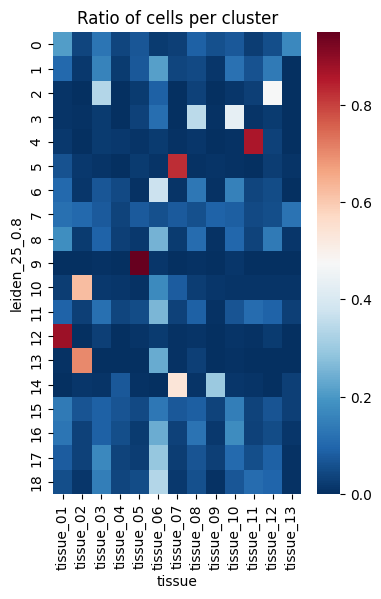

In [13]:

plt.rcParams['figure.figsize'] = [4, 6]

sns.heatmap(data = cells_per_cluster_per_tissue, cmap="RdBu_r").set(title='Ratio of cells per cluster')
plt.savefig('cells_per_cluster_heatmap.png', dpi=400)

Heatmap of data normalized by the number of cells in each tissue.

In [15]:
cells_per_cluster_per_tissue = pd.crosstab(adata.obs['leiden_25_0.8'], adata.obs['tissue'], normalize='columns')
cells_per_cluster_per_tissue.head()

tissue,tissue_01,tissue_02,tissue_03,tissue_04,tissue_05,tissue_06,tissue_07,tissue_08,tissue_09,tissue_10,tissue_11,tissue_12,tissue_13
leiden_25_0.8,,,,,,,,,,,,,
0,0.283528,0.089871,0.197709,0.241807,0.124101,0.025090,0.047213,0.163629,0.316111,0.113976,0.040395,0.084525,0.673222
1,0.092085,0.028737,0.159182,0.084738,0.085154,0.169245,0.040140,0.059343,0.043938,0.126482,0.067325,0.148454,0.005323
2,0.007375,0.000446,0.311239,0.001873,0.021850,0.061794,0.000725,0.035689,0.000610,0.013217,0.029258,0.454621,0.000000
3,0.007728,0.006336,0.016984,0.010300,0.030893,0.072698,0.000786,0.349798,0.020138,0.370081,0.008431,0.016976,0.000591
4,0.010759,0.000714,0.013336,0.045646,0.008053,0.010860,0.004353,0.010296,0.003255,0.004801,0.674322,0.023802,0.000296


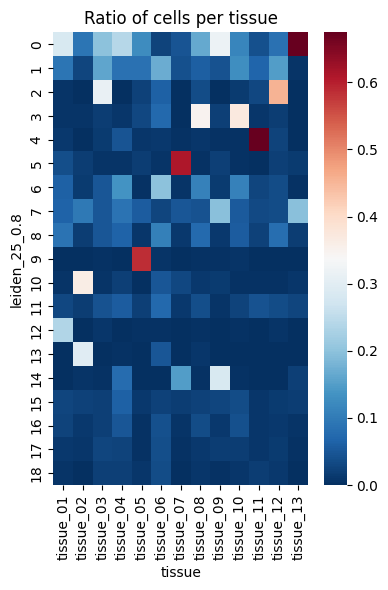

In [18]:
sns.heatmap(data = cells_per_cluster_per_tissue, cmap="RdBu_r").set(title='Ratio of cells per tissue')
plt.tight_layout()
plt.savefig('cells_per_cluster_heatmap_normalized_by_cellcount.png')

QC metrics per cluster and tissue  

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0

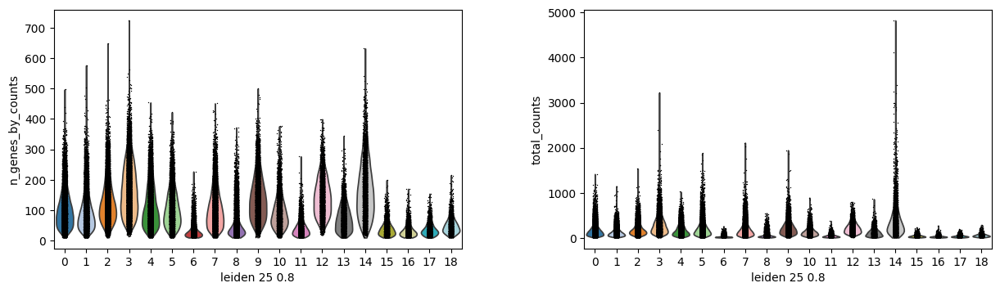

/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/project/soft/linux64/anaconda/Anaconda3-2023.09-0

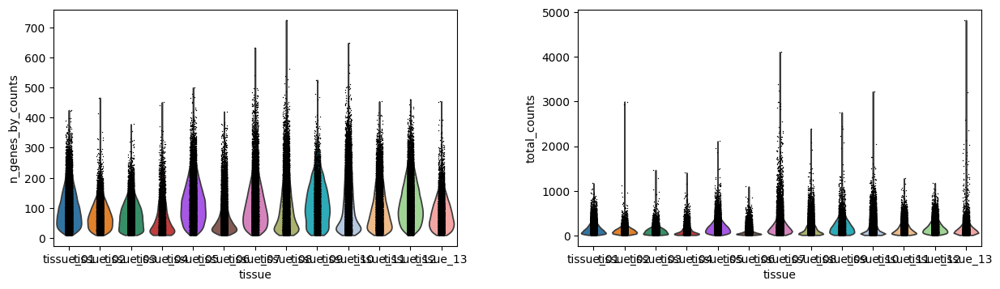

In [19]:
plt.rcParams['figure.figsize'] = [6, 4]
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'], groupby='leiden_25_0.8' )
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'], groupby='tissue' )

## DEGs analysis and cluster cell type annotation

In [2]:
# Checkpoint - read in the clustered object
adata = sc.read_h5ad('/project/data/gew123/Spatial/Objects/spatial_clustered_unlabelled.h5ad')

In [3]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,...,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_genes,leiden_25_0.7,leiden_25_0.8,leiden_25_1.0
3_1,1,10996,2.06,95170.997899,99963.034702,183,89,52,4561,37,...,100.000000,100.0,100.0,0,0.000000,0.000000,75,15,15,17
5_1,1,9341,0.82,95468.997899,99760.034702,102,124,332,2770,341,...,100.000000,100.0,100.0,1,0.693147,2.083333,36,0,0,21
6_1,1,4901,1.26,95379.997899,99721.034702,92,73,340,692,867,...,100.000000,100.0,100.0,0,0.000000,0.000000,43,0,0,21
7_1,1,8042,0.76,95249.997899,99688.034702,93,123,380,1287,618,...,100.000000,100.0,100.0,0,0.000000,0.000000,11,5,6,5
8_1,1,3137,0.72,95412.997899,99681.034702,63,87,569,1201,915,...,100.000000,100.0,100.0,0,0.000000,0.000000,34,2,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
471_202,202,4170,0.92,81967.003876,56219.283252,82,89,2288,14766,404,...,100.000000,100.0,100.0,0,0.000000,0.000000,68,0,0,2
473_202,202,4561,1.39,82186.003876,56182.283252,97,70,3171,17822,511,...,98.235294,100.0,100.0,0,0.000000,0.000000,103,1,7,7
474_202,202,6188,1.43,82094.003876,56138.283252,109,76,3346,16071,405,...,100.000000,100.0,100.0,0,0.000000,0.000000,60,0,0,6
475_202,202,4717,1.08,81896.003876,56118.283252,81,75,2092,13187,438,...,100.000000,100.0,100.0,0,0.000000,0.000000,65,0,0,6


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


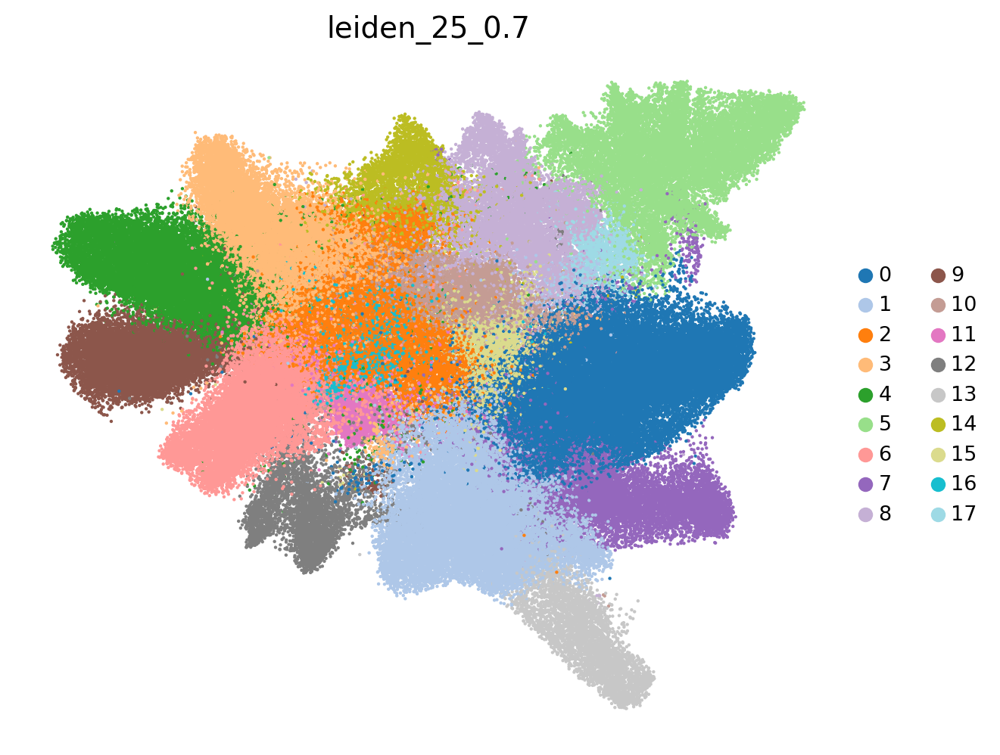

In [16]:
# Let's check the UMAP
sc.set_figure_params(dpi=100, dpi_save=400, figsize=(7,6))
sc.settings.figdir = '/project/data/gew123/Spatial/Manual_Annotation/All_tissues'


sc.pl.umap(adata, color=['leiden_25_0.7'], size=10, wspace=0.4,
           #legend_loc='on data',
           legend_fontsize='x-small',
           palette='tab20',
           frameon=False,
           save='_final_clusters_alltissues.png')

In [23]:
adata

AnnData object with n_obs × n_vars = 182735 × 1000
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.CD45', 'Max.CD45', 'Mean.DAPI', 'Max.DAPI', 'tissue', 'section', 'subtype', 'stage', 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'leiden_25_0.7', 'leiden_25_0.8', 'leiden_25_1.0'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'leiden', 'leiden_25_0.7_colors', 'leiden_25_0.8_colors', 'leiden_25_1.0_colors', 'log1p', 'neighbors', 'pca', 'spatial', 'tissue_colors', 'umap', 'dendrogram_leiden_25_0.7'
    obsm: 'X_

### Investigating the general immune population based on a custom marker list  

In [48]:
# List generated from cross section of CosMx panel and literature markers
marker_genes_immune_dictionary = {
    "CD45": ["PTPRC"],
    "B cell": ["CD19", "MS4A1", "CD79A", "CD27"],
    "Plasma": ["CD38", "TNFRSF17", "JCHAIN"],
    "T cell": ["CD3D", "CD3E", "CD3G", "CD4","FOXP3", "CD8A", "CD8B", "CCL5"],
   # "NK": ["GNLY", "GZMB"],
    #"Myeloid": ["CD14", "CD68", "CD163", "CSF1R", "ITGAX"],
   # "M1 Macrophages": ["CXCL5", "CD209"],
    #"Macrophages": ["C1QC", "SPP1", "CXCL9", "LYZ"]
}    

categories: 0, 1, 2, etc.
var_group_labels: CD45, B cell, Plasma, etc.


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


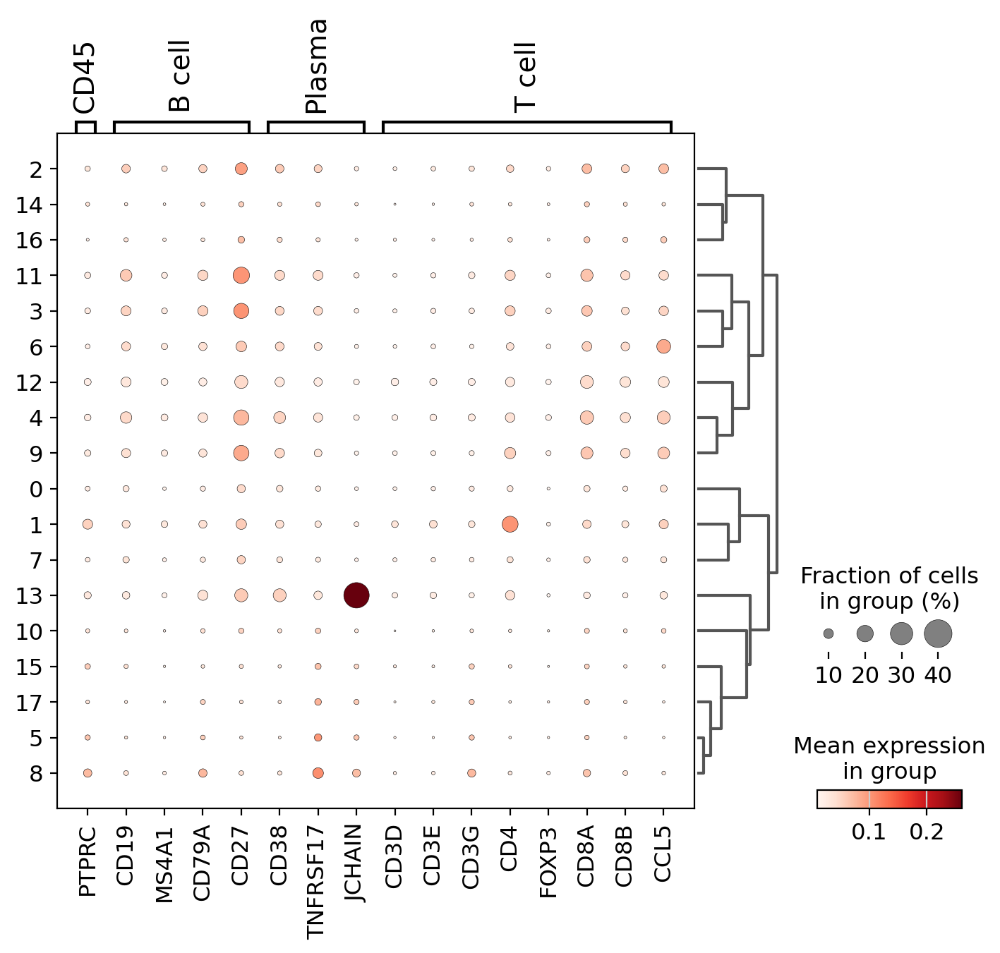

In [49]:
sc.pl.dotplot(adata, marker_genes_immune_dictionary, 'leiden_25_0.7', dendrogram=True, save='_alltissues_preliminary.png')

In [51]:
# Now let's try expanding the marker list, subsetting to those in our data, and plotting
immune_markers = pd.read_csv('/project/data/gew123/Cell_Annotation/markers/immune_markers_final.csv')

In [52]:
immune_markers

,gene,cell_label
0,ZBTB16,NKT
1,KLRG1,NKT
2,TRGC1,NKT
3,CD38,NKT
4,CD16,NKT
...,...,...
93,CD15,MDSC
94,LOX1,MDSC
95,CD11b,MDSC
96,CD84,MDSC


In [69]:
# (1) Convert to dictionary
def create_gene_marker_dict(df):
    gene_marker_dict = {}

    # Group the dataframe by unique cell types
    grouped = df.groupby('cell_label')

    # For each group
    for marker, group in grouped:
        # Get list of genes corresponding to cell type
        genes = group['gene'].tolist()
        # Update dict
        gene_marker_dict[marker] = genes

    return gene_marker_dict

# (2) Subset to only the genes found in data
def find_markers_in_data(marker_dict, adata):
    
    nb_markers_filtered = {}
    
    for cell_type, markers in marker_dict.items():

        markers_found = []

        for gene in markers:
            if gene in adata.var.index:
                markers_found.append(gene)

        # Update dict
        nb_markers_filtered[cell_type] = markers_found
        
    return nb_markers_filtered

# (3) Some cell types now have no markers, so subset to get those that have at least one
def get_marked_cell_types(marker_dict):
    marked_cell_types = {}
    
    for cell, markers in marker_dict.items():
        if isinstance(markers, list) and len(markers) > 0:
            marked_cell_types[cell] = markers
    
    return marked_cell_types


def get_unique_markers(cell_markers_dict):
    unique_markers = {}

    for cell_type, markers in cell_markers_dict.items():
        # Initialize a set to store gene markers that are unique to the current cell type
        unique_markers[cell_type] = set(markers)

        # Iterate through other cell types and remove common gene markers
        for other_cell_type, other_markers in cell_markers_dict.items():
            if other_cell_type != cell_type:
                unique_markers[cell_type] -= set(other_markers)

        # Convert the set back to a list
        unique_markers[cell_type] = list(unique_markers[cell_type])

    return unique_markers


In [70]:
# Call function to get dictionary
immune_markers_dict = create_gene_marker_dict(immune_markers)

# Call function to filter to markers found in data
immune_markers_filtered = find_markers_in_data(immune_markers_dict, adata)

# Call function to filter out empty cell marker lists
marked_cell_types_immune = get_marked_cell_types(immune_markers_filtered)

# Final immune markers
immune_markers_final = marked_cell_types_immune.copy()


# Get unique gene markers for each cell type
immune_markers_unique = get_unique_markers(immune_markers_final)

# Remove empty cell types
immune_markers_unique = get_marked_cell_types(immune_markers_unique)

In [71]:
immune_markers_unique

{'Active T cells': ['CD44'],
 'B cells': ['IGHM', 'CXCR5', 'CD83', 'CD69', 'CD19', 'TCL1A', 'IGHD'],
 'Helper T cells (CD4+)': ['CD4'],
 'M1 Macrophages': ['CD86', 'CD80', 'CD68'],
 'M2 Macrophages': ['CD163'],
 'MDSC': ['CXCR1', 'CD84', 'CD33'],
 'Macrophages': ['CD36', 'CCL2', 'CD74', 'CD47'],
 'NKT': ['ZBTB16'],
 'Naïve T cells': ['SELL', 'CCR7', 'IL7R'],
 'Plasma cells': ['JCHAIN', 'FKBP11', 'MZB1', 'XBP1'],
 'Proliferating M cells': ['LYZ'],
 'Proliferating T cells': ['CD3D', 'CD3E', 'CD3G'],
 'Tregs': ['FOXP3',
  'TGFB1',
  'IL2RA',
  'CD70',
  'CTLA4',
  'LGALS1',
  'ENTPD1',
  'TNFRSF4',
  'TNFRSF9',
  'TNFRSF18',
  'TIGIT']}

In [72]:
# Clean up the list by grouping cell types and deleting ones we aren't interested in
del immune_markers_final['M1 Macrophages']
del immune_markers_final['M2 Macrophages']
del immune_markers_final['MDSC']

In [83]:
types

['Macrophages', 'M1 Macrophages', 'M2 Macrophages', 'Proliferating M cells']

In [94]:
# Group similar cell types together
groupings = {'Myeloid cells' : ['Macrophages', 'M1 Macrophages', 'M2 Macrophages', 'Proliferating M cells'],
             'T cells' : ['Helper T cells (CD4+)', 'NKT', 'Tregs', 'Active T cells', 'Naïve T cells', 'Proliferating T cells'],
             'B cells' : ['B cells'],
             'Plasma cells' : ['Plasma cells'],            
            }

# Apply groupings
new_immune_markers = {}

for group, types in groupings.items():
    # Get unique markers across all merging groups
    markers = []
    
    for cell in types:
        current_markers = immune_markers_unique[cell]
        all_markers = list(set(markers + current_markers))
        markers = all_markers
        
    new_immune_markers[group] = all_markers

In [95]:
# CD74 is skewing the data, remove it
new_immune_markers['Myeloid cells'].remove('CD74')

In [96]:
new_immune_markers

{'Myeloid cells': ['CD86',
  'LYZ',
  'CD36',
  'CCL2',
  'CD163',
  'CD47',
  'CD68',
  'CD80'],
 'T cells': ['FOXP3',
  'CTLA4',
  'SELL',
  'TIGIT',
  'TGFB1',
  'IL7R',
  'IL2RA',
  'CD4',
  'TNFRSF18',
  'CD44',
  'LGALS1',
  'CD3G',
  'CD3D',
  'CCR7',
  'CD70',
  'TNFRSF9',
  'CD3E',
  'ENTPD1',
  'TNFRSF4',
  'ZBTB16'],
 'B cells': ['IGHM', 'CXCR5', 'CD83', 'CD69', 'CD19', 'TCL1A', 'IGHD'],
 'Plasma cells': ['MZB1', 'FKBP11', 'JCHAIN', 'XBP1']}

categories: 0, 1, 2, etc.
var_group_labels: Myeloid cells, T cells, B cells, etc.


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


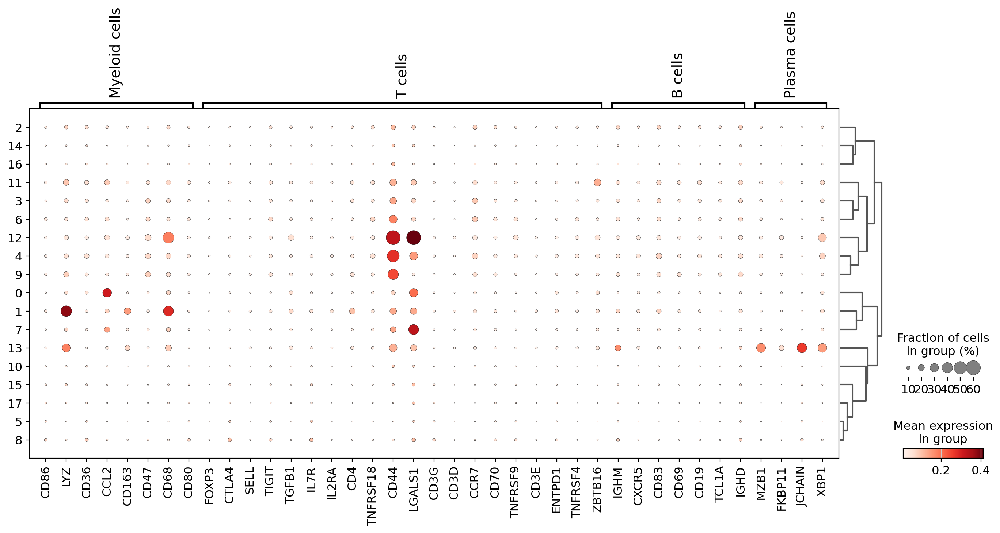

In [98]:
# Plot
sc.pl.dotplot(adata, new_immune_markers, 'leiden_25_0.7', dendrogram=True, save='_alltissues_secondary.png')

# looks like CD74 is dominating - remove and replot

### Investigating the sympathoadrenal populations based on a custom marker list  

In [171]:
# Get markers
nb_markers = pd.read_csv('/project/data/gew123/Cell_Annotation/nb_cell_markers_final.csv')
del nb_markers['Unnamed: 0']

In [173]:
nb_markers_unfiltered = {}
for key, value in nb_markers.iloc:
    nb_markers_unfiltered[key] = [i[1:len(i)-1] for i in value[1:len(value)-1].split(', ')]
nb_markers_unfiltered

{'Adrenal cortex': ['STAR', 'CYP11A1', 'CYP11B1'],
 'Bridge': ['SOX10',
  'PLP1',
  'PHOX2B',
  'HAND2',
  'ISL1',
  'ERBB4',
  'VGF',
  'MYCN'],
 'Cycling chromaffin': ['CHGA', 'CHGB', 'PENK', 'TOP2A'],
 'Cycling neuroblasts': ['PRPH',
  'ISL1',
  'RET',
  'PHOX2B',
  'HAND2',
  'GATA3',
  'MKI67',
  'TOP2A'],
 'Differentiation': ['DLK1', 'RET', 'STMN4', 'DLK1', 'RET'],
 'Endothelial cells': ['TEK',
  'PTPRB',
  'SOX18',
  'FLT1',
  'EGFL7',
  'PECAM1',
  'SOX17',
  'TIE1'],
 'Erythroblast': ['HBG1', 'HBG2', 'HBB'],
 'Erythrocytes': ['HBA2', 'HBG2', 'ANK1'],
 'Hepatocytes': ['ALB'],
 'Mesenchymal cells': ['COL1A1',
  'COL1A2',
  'YAP1',
  'PRRX1',
  'CXCL12',
  'PDGFRB',
  'DCN',
  'COL12A1',
  'COL6A3',
  'PDGFRA'],
 'Myocytes': ['TTN'],
 'Myofibroblasts': ['ACTA2', 'TAGLN', 'MYH11'],
 'Neuroblasts': ['GAP43',
  'SOX11',
  'TH',
  'HAND2',
  'NPY',
  'RET',
  'ISL1',
  'GATA3',
  'CCND1',
  'SOX4',
  'TFAP2B',
  'PRPH',
  'NEFM',
  'MEIS2',
  'PHOX2B',
  'STMN2'],
 'Progenitors': ['B

In [186]:
# Subset to those found in CosMx
nb_markers_filtered = find_markers_in_data(nb_markers_unfiltered, adata)
nb_markers_filtered = get_marked_cell_types(nb_markers_filtered)

# Group
nb_markers_filtered['SCPs'] = list(set(nb_markers_filtered['SCPs'] + nb_markers_filtered['Cycling SCPs']))
del nb_markers_filtered['Cycling SCPs']

nb_markers_filtered['Neuroblasts'] = list(set(nb_markers_filtered['Neuroblasts'] + nb_markers_filtered['Cycling neuroblasts']))
del nb_markers_filtered['Cycling neuroblasts']

nb_markers_filtered['Chromaffin'] =  nb_markers_filtered['Cycling chromaffin']
del nb_markers_filtered['Cycling chromaffin']

In [187]:
nb_markers_filtered

{'Endothelial cells': ['TEK', 'FLT1', 'PECAM1', 'TIE1'],
 'Erythroblast': ['HBB'],
 'Mesenchymal cells': ['COL1A1',
  'COL1A2',
  'CXCL12',
  'PDGFRB',
  'DCN',
  'COL12A1',
  'COL6A3',
  'PDGFRA'],
 'Myocytes': ['TTN'],
 'Myofibroblasts': ['ACTA2', 'TAGLN', 'MYH11'],
 'Neuroblasts': ['MKI67', 'SOX4', 'TOP2A', 'GATA3', 'CCND1'],
 'SCPs': ['ERBB3', 'MKI67', 'CDH19', 'TOP2A'],
 'Sympathetic neural progenitor cells': ['GATA3'],
 'Chromaffin': ['TOP2A']}

In [190]:
# Save
import csv
path = '/project/data/gew123/Spatial/Manual_Annotation/nb_markers_final_spatial.csv'

data = []
for cell_type, markers in nb_markers_filtered.items():
    for marker in markers:
        data.append((cell_type, marker))
        
# Write data to CSV file
with open(path, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Cell Type', 'Marker'])  # Write header
    writer.writerows(data)  # Write data rows

categories: 0, 1, 2, etc.
var_group_labels: Endothelial cells, Erythroblast, Mesenchymal cells, etc.


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


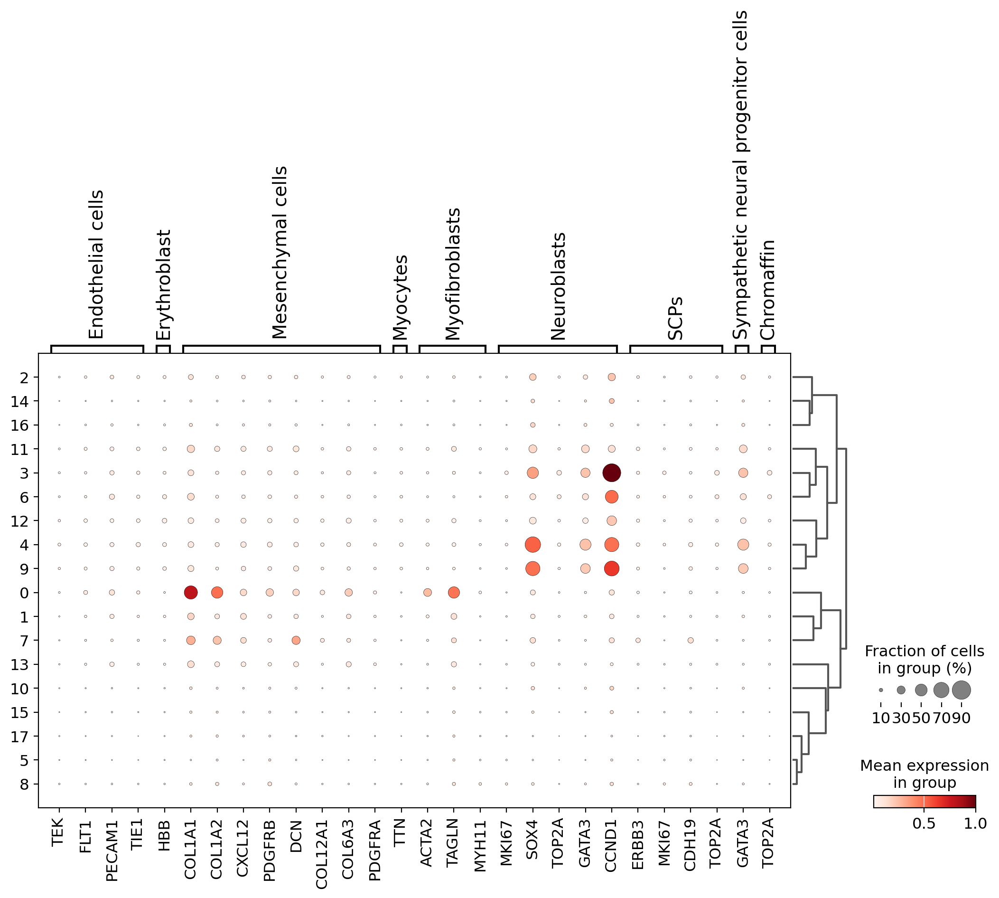

In [191]:
sc.pl.dotplot(adata, nb_markers_filtered, 'leiden_25_0.7', dendrogram=True, save='_alltissues_adrenal.png')

### DEGs

Calculating DEGs using Wilcoxon 

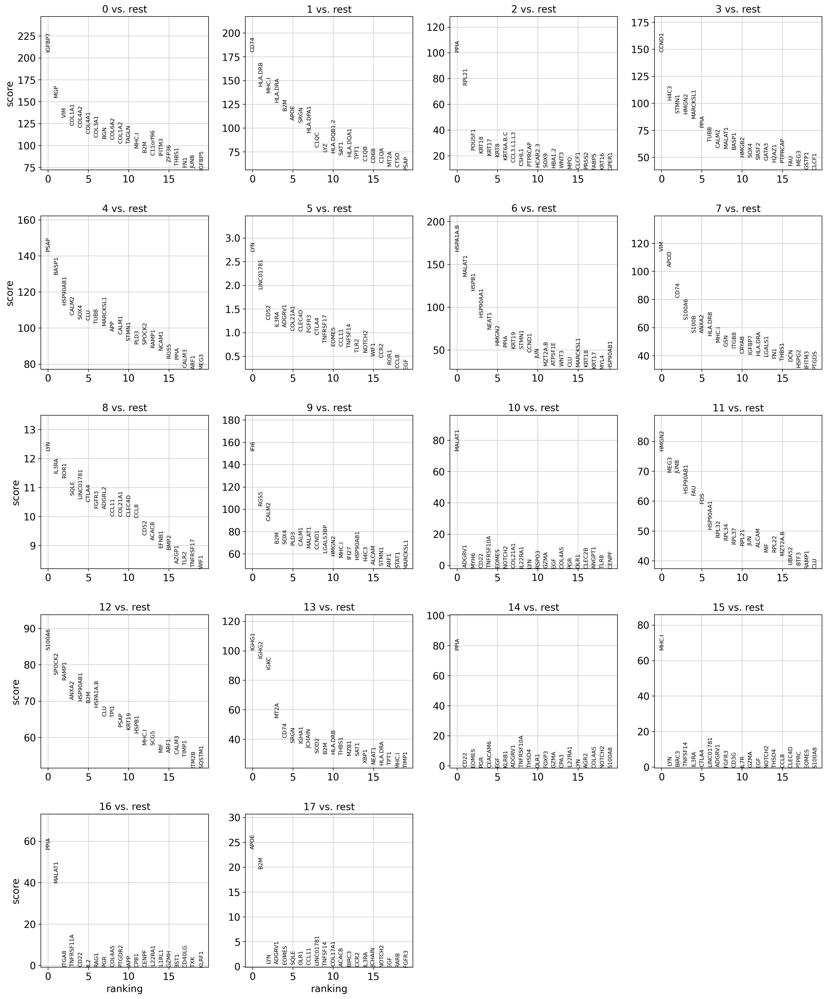

In [193]:
sc.tl.rank_genes_groups(adata, 'leiden_25_0.7', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, save='ranked_gene_groups.png')

In [195]:
def perform_de(adata, grouping, name):
    #calculate total genes
    total_genes = adata.shape[1]

    #calculate marker genes
    sc.tl.rank_genes_groups(adata, groupby=grouping,method='wilcoxon', key_added='rank_genes', n_genes = total_genes)
    sc.tl.filter_rank_genes_groups(adata, key = 'rank_genes', groupby=grouping)
    sc.pl.rank_genes_groups(adata, key='rank_genes', fontsize=12)

    sc.pl.rank_genes_groups_dotplot(adata, key='rank_genes_groups_filtered', save = "de_dotplot_" + grouping + "_" + name, n_genes=5)
    de  = pd.DataFrame({'genes':[],'logfoldchanges':[],'pvals':[],'cluster':[]})
    for group in set(adata.obs[grouping]):
        d = {'genes': adata.uns['rank_genes']['names'][group],\
         'logfoldchanges': adata.uns['rank_genes']['logfoldchanges'][group],\
         'pvals':adata.uns['rank_genes']['pvals'][group],\
         'pvals_adj':adata.uns['rank_genes']['pvals_adj'][group],\
         'cluster':group}
        de = pd.concat([de,pd.DataFrame(d)])

    de  = pd.DataFrame({'genes':[],'logfoldchanges':[],'pvals':[],'cluster':[]})
    for group in set(adata.obs[grouping]):
        d = {'genes': adata.uns['rank_genes_groups_filtered']['names'][group],\
         'logfoldchanges': adata.uns['rank_genes_groups_filtered']['logfoldchanges'][group],\
         'pvals':adata.uns['rank_genes_groups_filtered']['pvals'][group],\
         'pvals_adj':adata.uns['rank_genes_groups_filtered']['pvals_adj'][group],\
         'cluster':group}
        de = pd.concat([de,pd.DataFrame(d)])
    #de.to_csv("../output/all_cells_nuc/wilcox_markers_filtered_" + grouping + "_" + name + ".csv")

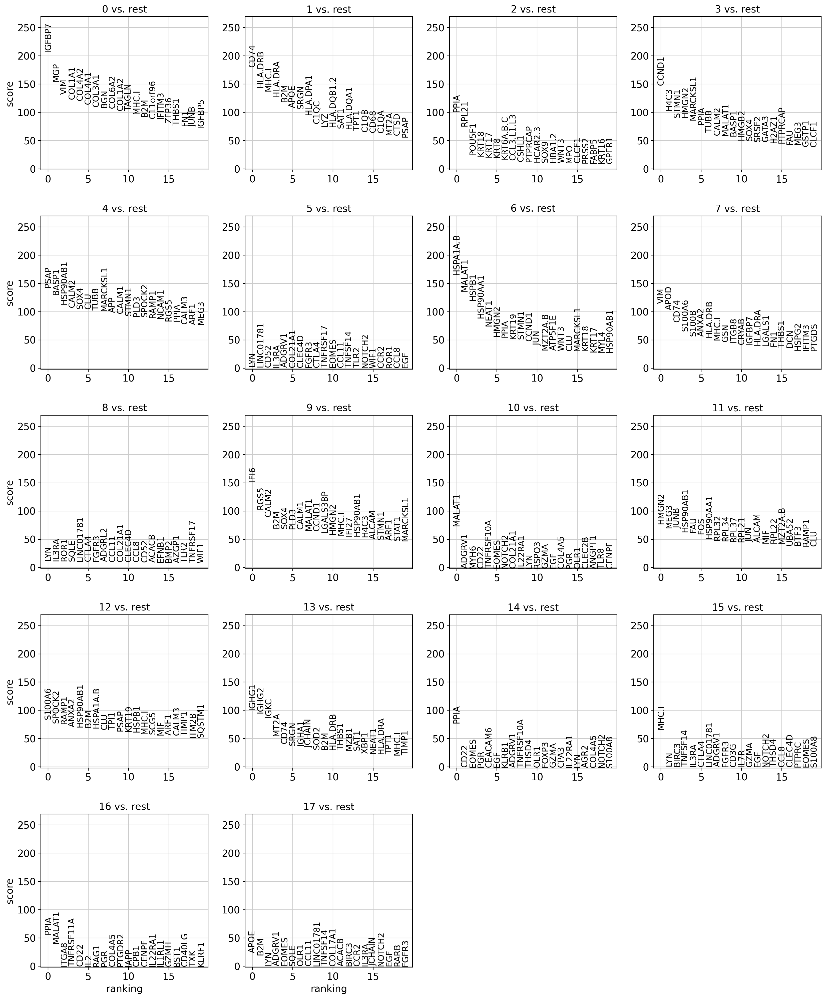

categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


/project/soft/linux64/anaconda/Anaconda3-2023.09-0-Linux-x86_64/lib/python3.11/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


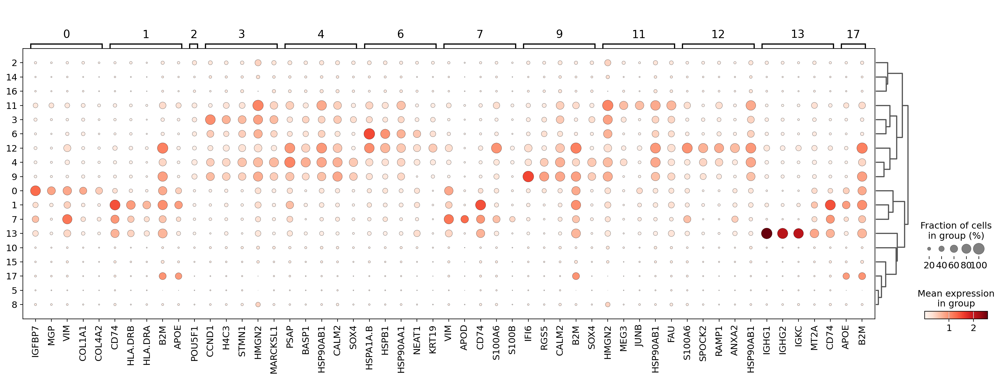

In [196]:
perform_de(adata, 'leiden_25_0.7', 'DEGs')

Top 15 DEGs per cluster  

In [197]:
pd.set_option('display.max_columns', None)
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(15)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,IGFBP7,CD74,PPIA,CCND1,PSAP,LYN,HSPA1A.B,VIM,LYN,IFI6,MALAT1,HMGN2,S100A6,IGHG1,PPIA,MHC.I,PPIA,APOE
1,MGP,HLA.DRB,RPL21,H4C3,BASP1,LINC01781,MALAT1,APOD,IL3RA,RGS5,ADGRV1,MEG3,SPOCK2,IGHG2,CD22,LYN,MALAT1,B2M
2,VIM,MHC.I,POU5F1,STMN1,HSP90AB1,CD52,HSPB1,CD74,ROR1,CALM2,MYH6,JUNB,RAMP1,IGKC,EOMES,BIRC3,ITGA8,LYN
3,COL1A1,HLA.DRA,KRT18,HMGN2,CALM2,IL3RA,HSP90AA1,S100A6,SQLE,B2M,CD22,HSP90AB1,ANXA2,MT2A,PGR,TNFSF14,TNFRSF11A,ADGRV1
4,COL4A2,B2M,KRT17,MARCKSL1,SOX4,ADGRV1,NEAT1,S100B,LINC01781,SOX4,TNFRSF10A,FAU,HSP90AB1,CD74,CEACAM6,IL3RA,CD22,EOMES
5,COL4A1,APOE,KRT8,PPIA,CLU,COL21A1,HMGN2,ANXA2,CTLA4,PLD3,EOMES,FOS,B2M,SRGN,EGF,CTLA4,IL2,SQLE
6,COL3A1,SRGN,KRT6A.B.C,TUBB,TUBB,CLEC4D,PPIA,HLA.DRB,FGFR3,CALM1,NOTCH2,HSP90AA1,HSPA1A.B,IGHA1,KLRB1,LINC01781,RAG1,OLR1
7,BGN,HLA.DPA1,CCL3.L1.L3,CALM2,MARCKSL1,FGFR3,KRT19,MHC.I,ADGRL2,MALAT1,COL21A1,RPL32,CLU,JCHAIN,ADGRV1,ADGRV1,PGR,CCL11
8,COL6A2,C1QC,CSHL1,MALAT1,APP,CTLA4,STMN1,GSN,CCL11,CCND1,IL22RA1,RPL34,TPI1,SOD2,TNFRSF10A,FGFR3,COL4A5,LINC01781
9,COL1A2,LYZ,PTPRCAP,BASP1,CALM1,TNFRSF17,CCND1,ITGB8,COL21A1,LGALS3BP,LYN,RPL37,PSAP,B2M,THSD4,CD3G,PTGDR2,TNFSF14


Extracting the results with p value

In [198]:
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
DEGs_slice_1 = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']})
DEGs_slice_1.head()

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p,11_n,11_p,12_n,12_p,13_n,13_p,14_n,14_p,15_n,15_p,16_n,16_p,17_n,17_p
0,IGFBP7,0.0,CD74,0.0,PPIA,0.000000e+00,CCND1,0.0,PSAP,0.0,LYN,0.006547,HSPA1A.B,0.0,VIM,0.0,LYN,1.294551e-34,IFI6,0.0,MALAT1,0.000000,HMGN2,0.0,S100A6,0.0,IGHG1,0.0,PPIA,0.000000,MHC.I,0.000000,PPIA,0.000000,APOE,4.388493e-123
1,MGP,0.0,HLA.DRB,0.0,RPL21,0.000000e+00,H4C3,0.0,BASP1,0.0,LINC01781,0.053974,MALAT1,0.0,APOD,0.0,IL3RA,1.430923e-30,RGS5,0.0,ADGRV1,0.176466,MEG3,0.0,SPOCK2,0.0,IGHG2,0.0,CD22,0.408195,LYN,0.373204,MALAT1,0.000000,B2M,2.800321e-86
2,VIM,0.0,MHC.I,0.0,POU5F1,6.299179e-134,STMN1,0.0,HSP90AB1,0.0,CD52,0.202610,HSPB1,0.0,CD74,0.0,ROR1,8.946003e-30,CALM2,0.0,MYH6,0.163203,JUNB,0.0,RAMP1,0.0,IGKC,0.0,EOMES,0.299557,BIRC3,0.586759,ITGA8,0.729899,LYN,5.066424e-01
3,COL1A1,0.0,HLA.DRA,0.0,KRT18,6.418692e-109,HMGN2,0.0,CALM2,0.0,IL3RA,0.258088,HSP90AA1,0.0,S100A6,0.0,SQLE,7.133641e-27,B2M,0.0,CD22,0.153645,HSP90AB1,0.0,ANXA2,0.0,MT2A,0.0,PGR,0.288415,TNFSF14,0.618118,TNFRSF11A,0.671092,ADGRV1,6.088469e-01
4,COL4A2,0.0,B2M,0.0,KRT17,2.106711e-93,MARCKSL1,0.0,SOX4,0.0,ADGRV1,0.264430,NEAT1,0.0,S100B,0.0,LINC01781,2.663315e-26,SOX4,0.0,TNFRSF10A,0.138703,FAU,0.0,HSP90AB1,0.0,CD74,0.0,CEACAM6,0.264806,IL3RA,0.784702,CD22,0.628924,EOMES,6.688524e-01


In [204]:
DEGs_slice_1.to_csv('/project/data/gew123/Spatial/Manual_Annotation/top_5_DEGs_pvals.csv')

Additional visualizations  

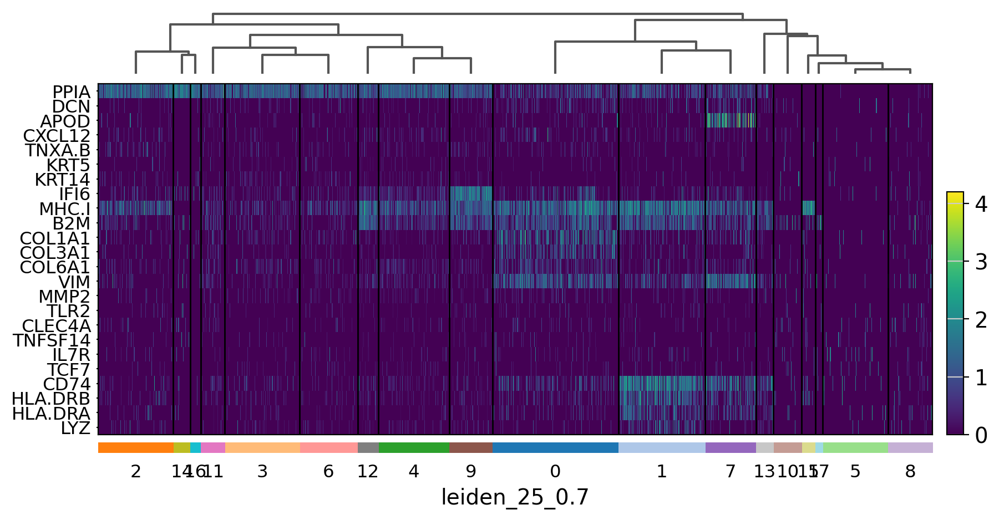

In [202]:
plt.rcParams['figure.figsize'] = [12, 6]
markers = ['PPIA', 'DCN', 'APOD', 'CXCL12', 'TNXA.B', 
           'KRT5', 'KRT14', 'IFI6', 'MHC.I', 'B2M',
           'COL1A1', 'COL3A1', 'COL6A1', 'VIM', 'MMP2',
           'TLR2', 'CLEC4A', 'TNFSF14', 'IL7R', 'TCF7',
           'CD74', 'HLA.DRB', 'HLA.DRA', 'LYZ'
          ]
sc.pl.heatmap(adata, markers, groupby='leiden_25_0.7', swap_axes=True, dendrogram=True)

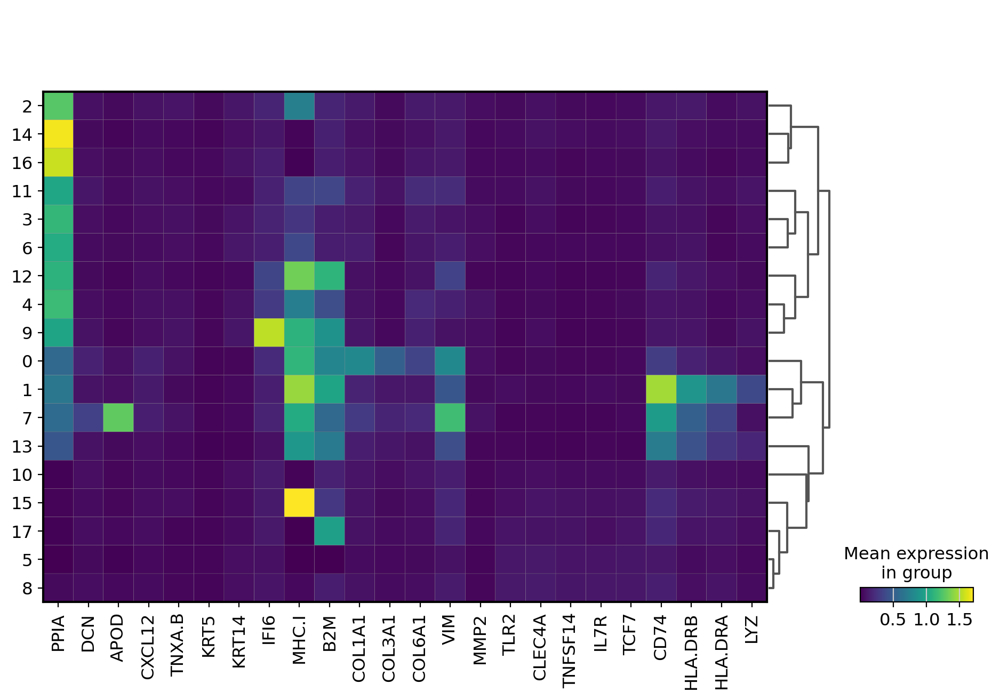

In [203]:
sc.pl.matrixplot(adata, markers, groupby='leiden_25_0.7', dendrogram=True)

A single-cell annotated dataset from the same tissue will help with the cell annotation. 

### Projecting UMAP onto the whole tissue  

In [101]:
df = pd.DataFrame(adata.obs)
df.head()

,Unnamed: 0,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,Max.PanCK,Mean.CD45,Max.CD45,Mean.DAPI,Max.DAPI,tissue,cell_ID,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_genes,leiden
3_1,1,1,10996,2.06,95170.997899,99963.034702,183,89,52,4561,37,660,55,3234,138,489,tissue_01,3,75,4.330733,92,4.532599,72.826087,100.0,100.0,100.0,0,0.000000,0.000000,75,13
5_1,3,1,9341,0.82,95468.997899,99760.034702,102,124,332,2770,341,1012,223,2604,514,1377,tissue_01,5,36,3.610918,48,3.891820,100.000000,100.0,100.0,100.0,1,0.693147,2.083333,36,20
6_1,4,1,4901,1.26,95379.997899,99721.034702,92,73,340,692,867,1332,220,976,665,1646,tissue_01,6,43,3.784190,83,4.430817,100.000000,100.0,100.0,100.0,0,0.000000,0.000000,43,6
7_1,5,1,8042,0.76,95249.997899,99688.034702,93,123,380,1287,618,1847,239,1108,547,1653,tissue_01,7,11,2.484907,12,2.564949,100.000000,100.0,100.0,100.0,0,0.000000,0.000000,11,2
8_1,6,1,3137,0.72,95412.997899,99681.034702,63,87,569,1201,915,1399,271,776,1034,1894,tissue_01,8,34,3.555348,44,3.806662,100.000000,100.0,100.0,100.0,0,0.000000,0.000000,34,5


In [102]:
# converting the cluster column to string
df['leiden'].apply(str)

3_1        13
5_1        20
6_1         6
7_1         2
8_1         5
           ..
471_202     5
473_202     9
474_202     6
475_202     6
476_202     6
Name: leiden, Length: 182735, dtype: category
Categories (25, object): ['0', '1', '2', '3', ..., '21', '22', '23', '24']

All cells coloured by cluster, however it is not 100% in the colour space between squidpy and the pallete used in seaborn. I am looking into a better solution to make them match better.

<Axes: xlabel='CenterX_global_px', ylabel='CenterY_global_px'>

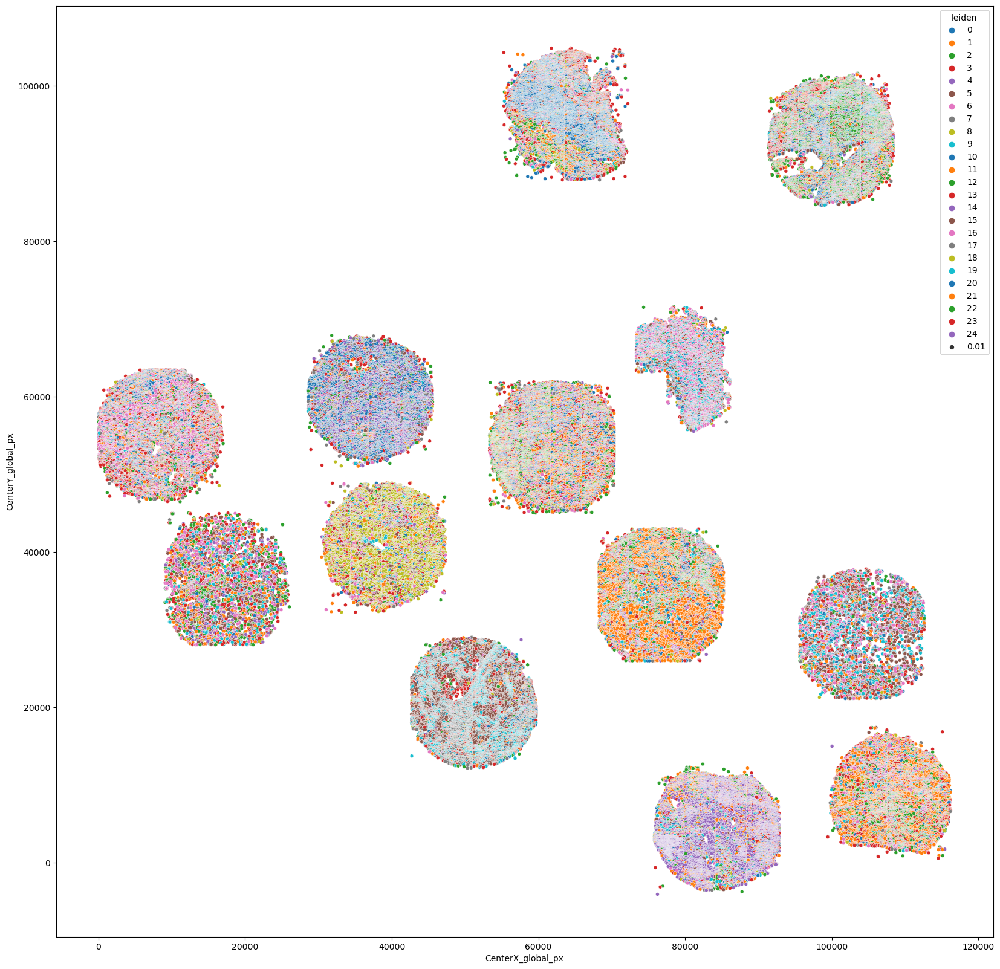

In [103]:
plt.rcParams['figure.figsize'] = [20, 20]
sns.scatterplot(data=df, x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)

Individual tissue sections

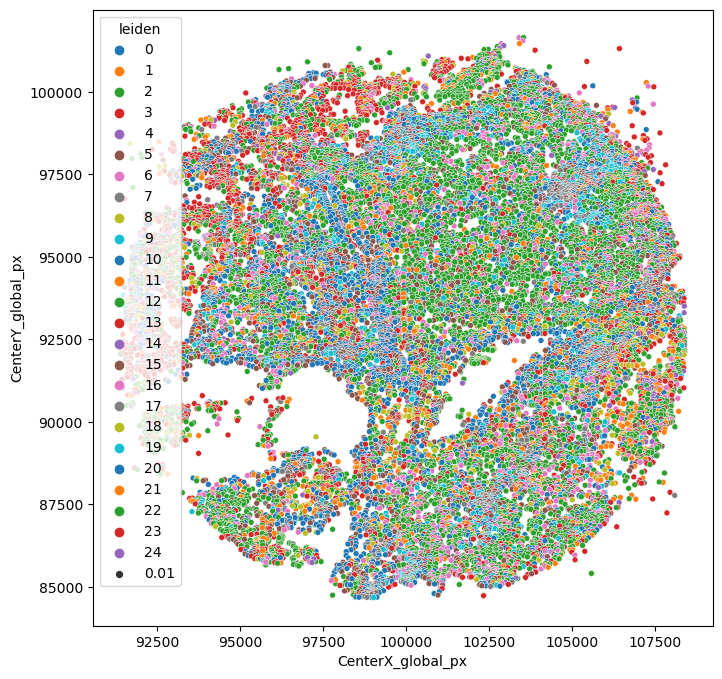

In [108]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_01"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

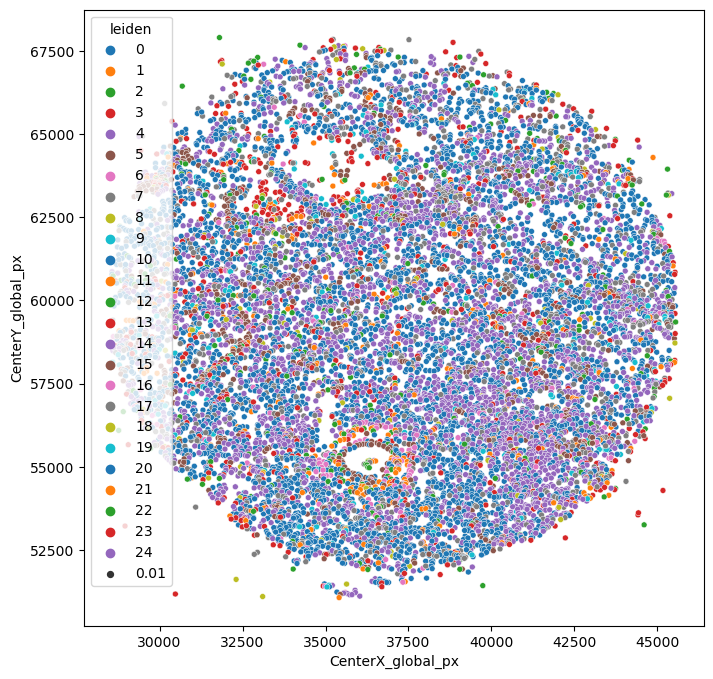

In [109]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_02"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

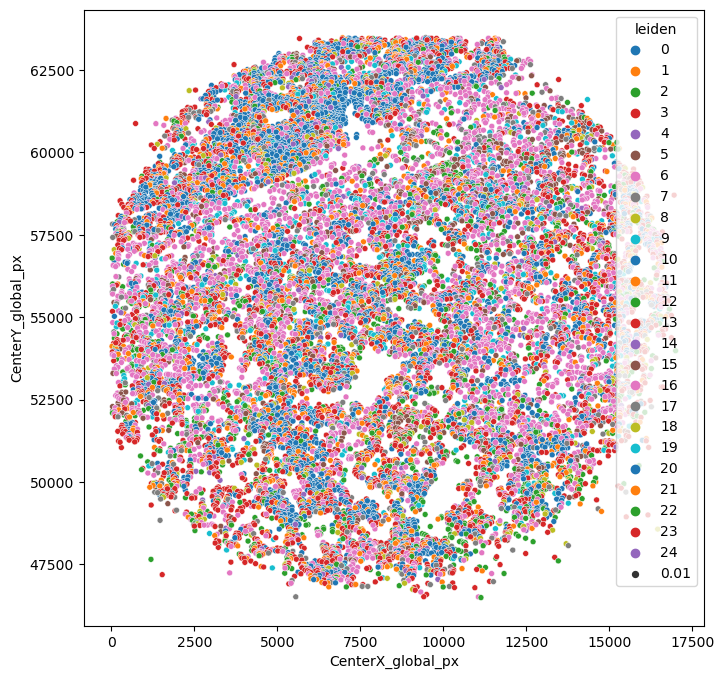

In [110]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_03"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

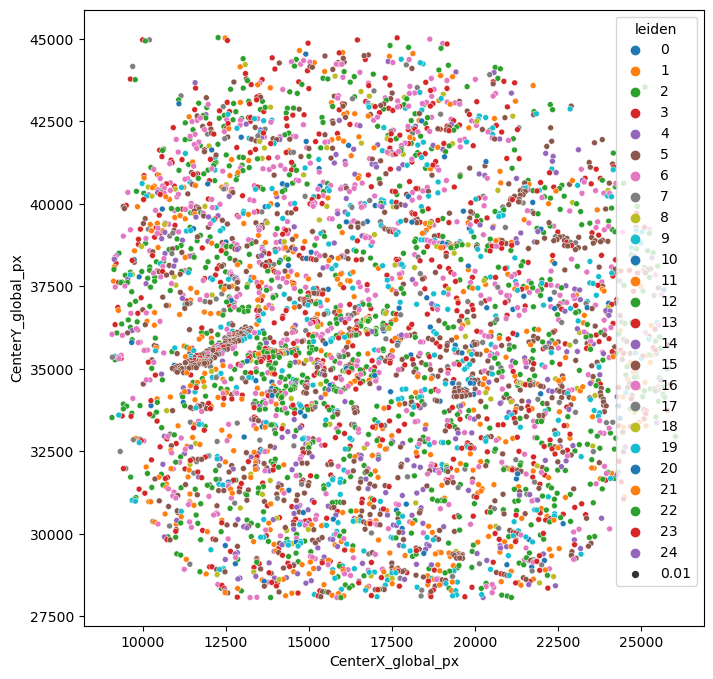

In [112]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_04"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

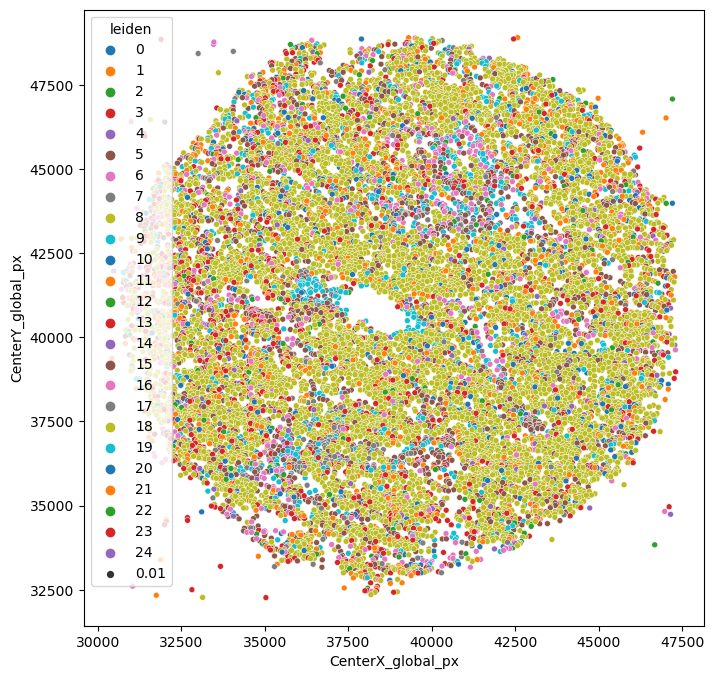

In [113]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_05"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

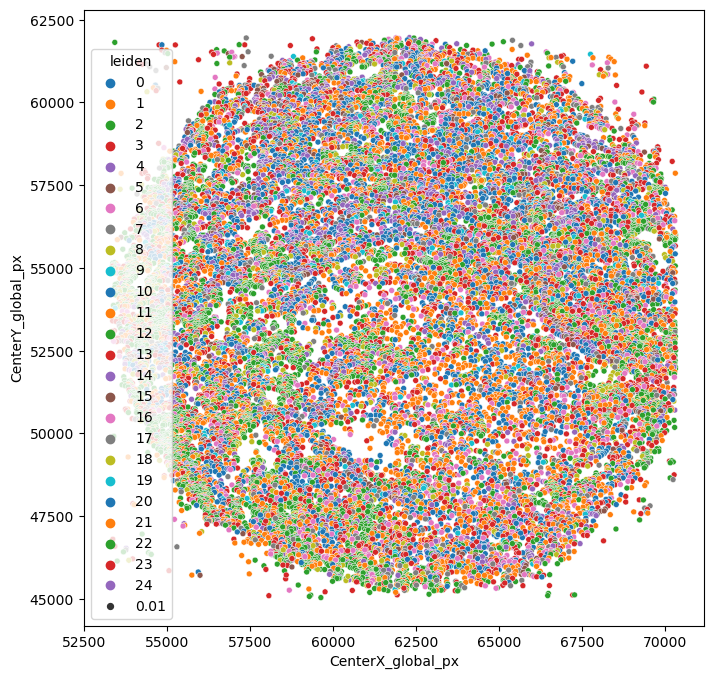

In [114]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_06"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

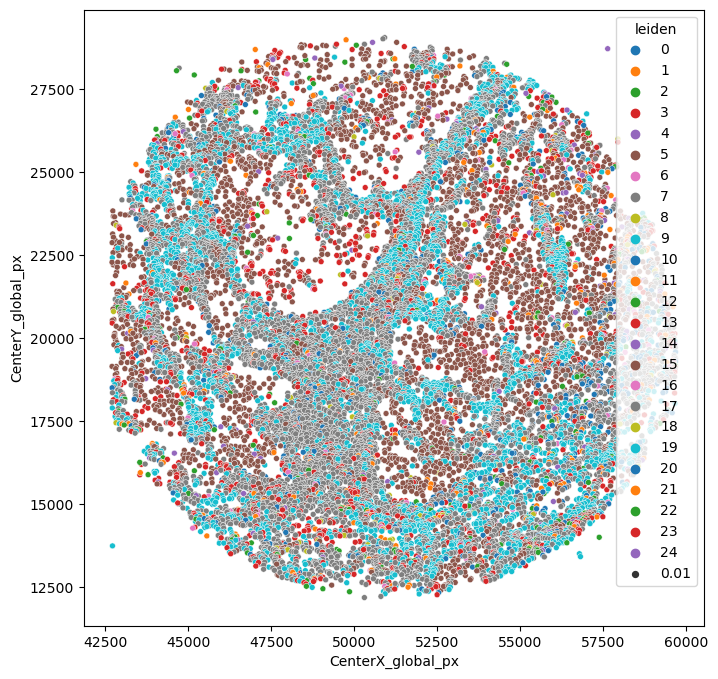

In [115]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_07"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

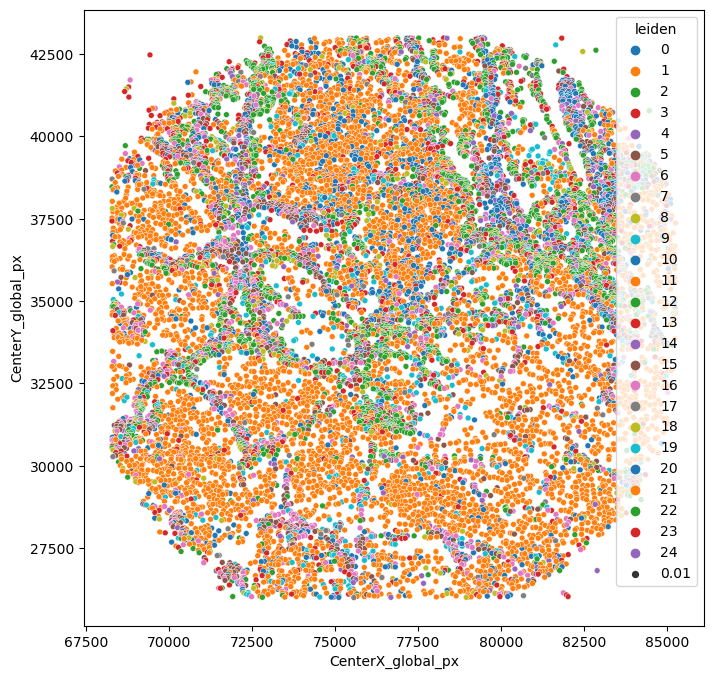

In [116]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_08"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

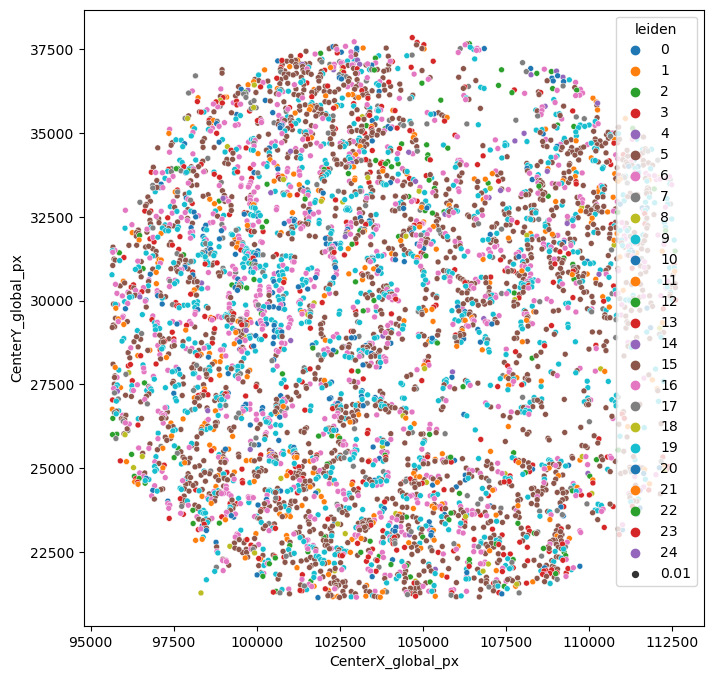

In [117]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_09"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

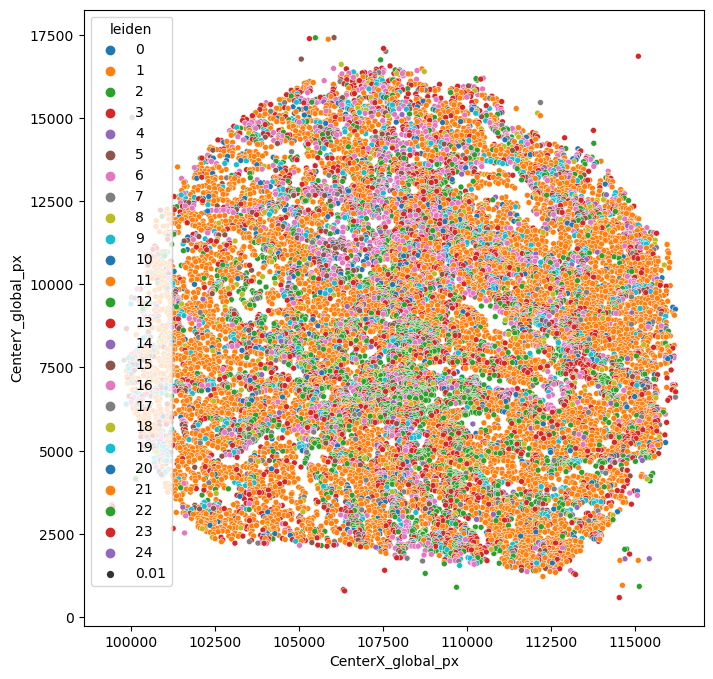

In [118]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_10"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

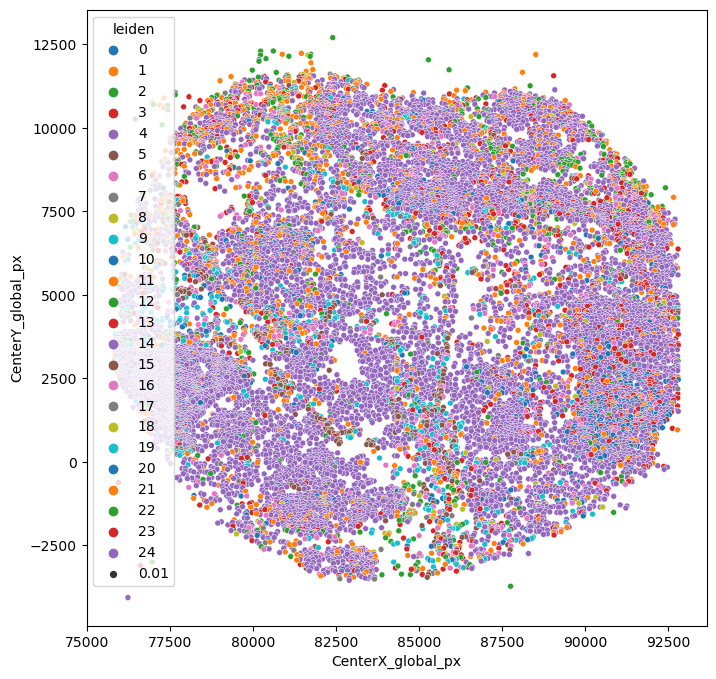

In [119]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_11"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

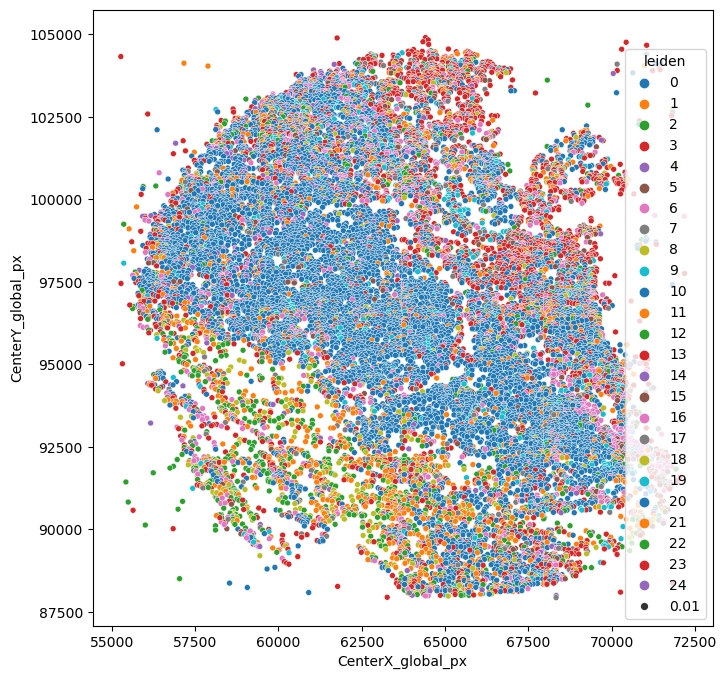

In [120]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_12"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

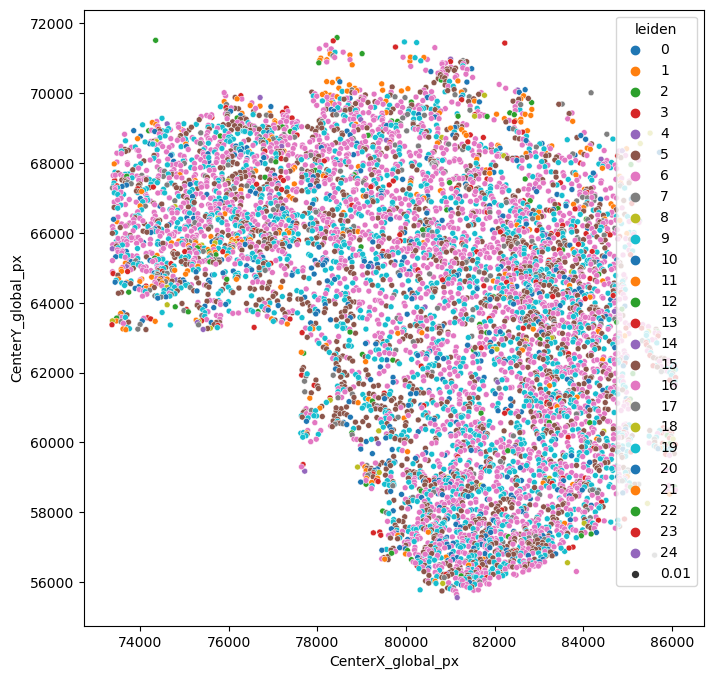

In [121]:
plt.rcParams['figure.figsize'] = [8, 8]
sns.scatterplot(data=df[df['tissue']=="tissue_13"], x='CenterX_global_px', y='CenterY_global_px', hue='leiden', palette="tab10", size=0.01)
plt.show()

## Individual FOV visualization  

In [ ]:
fig = plt.figure(figsize=(10,16))
ax = sns.scatterplot(data=fov_file, x='x_global_px', y='y_global_px', hue='tissue', palette='Set2', s=100)
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
for i, txt in enumerate(fov_file["fov"]):
    ax.text(fov_file["x_global_px"][i]*1.01, fov_file["y_global_px"][i]*1.01, txt)

### Tissue_01 area of interest

In [ ]:
fig, ax = plt.subplots(2, 3, figsize=(15, 15))

sq.pl.spatial_segment( adata, shape="hex", color="leiden", library_key="fov", library_id="79",
    seg_cell_id="cell_ID", img=False, size=40, ax=ax[0,0], seg_outline=True, title="FOV 79",)

sq.pl.spatial_segment( adata, shape="hex", color="leiden", library_key="fov", library_id="80",
    seg_cell_id="cell_ID", img=False, size=40, ax=ax[0,1], seg_outline=True, title="FOV 80",)

sq.pl.spatial_segment( adata, shape="hex", color="leiden", library_key="fov", library_id="81",
    seg_cell_id="cell_ID", img=False, size=40, ax=ax[0,2], seg_outline=True, title="FOV 81",)


sq.pl.spatial_segment( adata, shape="hex", color="leiden", library_key="fov", library_id="82",
    seg_cell_id="cell_ID", img=False, size=40, ax=ax[1,0], seg_outline=True, title="FOV 82",)

sq.pl.spatial_segment( adata, shape="hex", color="leiden", library_key="fov", library_id="83",
    seg_cell_id="cell_ID", img=False, size=40, ax=ax[1,1], seg_outline=True, title="FOV 83",)

sq.pl.spatial_segment( adata, shape="hex", color="leiden", library_key="fov", library_id="84",
    seg_cell_id="cell_ID", img=False, size=40, ax=ax[1,2], seg_outline=True, title="FOV 84",)




In [ ]:
plt.rcParams['figure.figsize'] = [5, 5]

### Gene expression in FOVs

In [ ]:
sq.pl.spatial_segment(
    adata,
    color="ACTA2",
    library_key="fov",
    library_id=["79", "80", "82", "83"],
    seg_cell_id="cell_ID",
    seg_outline=True,
)

sq.pl.spatial_segment(
    adata,
    color="APOA1",
    library_key="fov",
    library_id=["79", "80", "82", "83"],
    seg_cell_id="cell_ID",
    seg_outline=True,
)